In [1]:
import scanpy as sc
import pandas as pd

import scanpy as sc
import sys
sys.path.append("/nfs/team298/sm54/BoneAtlasProject/annotation")
from helper_functions import save_obs, restore_obs

from pathlib import Path

# Add project root to sys.path
repo_root = Path("/nfs/team298/sm54/BoneAtlasProject")
if str(repo_root) not in sys.path:
    sys.path.insert(0, str(repo_root))

# Now import
from metadata.marker_genes.marker_dict import marker_dict
import json
import numpy as np
import pandas as pd
from scipy.stats import fisher_exact
import importlib, annotation
importlib.reload(annotation)
from annotation import (
    annotate_broad_topN,      # automatic broad annotation per cluster using marker enrichment
    extract_topN_from_rgg,    # extract top-N DEGs per cluster from scanpy rank_genes_groups
    top_genes_for_cluster,    # return DEGs for one cluster (table or list)
    attach_broad_annotations  # attach a manual/auto cluster→broad label mapping to adata.obs
)
#


In [2]:
adata_full= sc.read_h5ad('/lustre/scratch124/cellgen/haniffa/users/sm54/data/Bone_Atlas/bone_atlas_best_embedding_with_all_genes_log_normalised.h5ad') 


In [4]:
import json

with open("/nfs/team298/sm54/BoneAtlasProject/metadata/cell_metadata/Bone_Atlas_Manual_Annotation_leiden_res_3.json", "r") as f:
    manual_annotation = json.load(f)

In [5]:
restore_obs(adata_full, "/nfs/team298/sm54/BoneAtlasProject/metadata/cell_metadata/bone_atlas_adata_full.obs.parquet", strict=True)


[replace_obs] adata.obs replaced with 96 cols for 1566868 rows.


In [6]:
adata_full.obs['fig_3_4'] = adata_full.obs['leiden_res_3'].astype(str).map(manual_annotation)


In [35]:
# columns you want to transfer
cols_to_transfer = [
    'published_anno', 'published_anno_2', 'published_anno_level1', 'published_anno_level2',
    'scrublet_score', 'predicted_doublets', 'scrublet_cluster_score', 'bh_pval',
    'predicted_doublets_pval', 'propagated_anno_gpu', 'propagated_anno_gpu_level2',
    'propagated_anno_gpu_level1', 'propagated_anno_knn', 'propagated_anno_knn_level2',
    'propagated_anno_knn_level1', 'broad_anno', 'fig_3_4', 'major_celltype', 'leiden'
]

# find overlapping cells
common_cells = adata.obs_names.intersection(adata_full.obs_names)

# transfer the annotations
adata.obs.loc[common_cells, cols_to_transfer] = adata_full.obs.loc[common_cells, cols_to_transfer].values

# check


(adata.obs[cols_to_transfer].head())


,published_anno,published_anno_2,published_anno_level1,published_anno_level2,scrublet_score,predicted_doublets,scrublet_cluster_score,bh_pval,predicted_doublets_pval,propagated_anno_gpu,propagated_anno_gpu_level2,propagated_anno_gpu_level1,propagated_anno_knn,propagated_anno_knn_level2,propagated_anno_knn_level1,broad_anno,fig_3_4,major_celltype,leiden
Cell_ID,,,,,,,,,,,,,,,,,,,
CGCAATGTCAGCAAGA-HCA_BN_F12482363,NaN,NaN,NaN,NaN,0.002760,False,0.001950,0.681097,False,Erythroid,Erythroid,Haematopoietic,Erythroid,Erythroid,Haematopoietic,Erythroid,Erythroid (Late),Erythroid,67
TAATCACCAATTGACT-HCA_BN_F12482363,NaN,NaN,NaN,NaN,0.004377,True,0.001950,0.681097,False,ERYTHROCYTE,Erythroid,Erythroid,ERYTHROCYTE,Erythroid,Erythroid,Myeloid_Haem,Muscle & Erythroid,Muscle,22
CAAGTAACATGACTAT-HCA_BN_F12482363,NaN,NaN,NaN,NaN,0.001950,False,0.001950,0.681097,False,Epithelial,Epithelial,Stroma,Epithelial,Epithelial,Stroma,Epidermis,Progenitor Neuroepithelial (Cycling),Epithelial/Epidermis,55
AAAGCCGCATGTTGCA-HCA_BN_F12482363,NaN,NaN,NaN,NaN,0.001463,False,0.001301,0.728714,False,Erythroid,Erythroid,Haematopoietic,Erythroid,Erythroid,Haematopoietic,Myeloid_Haem,Muscle & Erythroid,Muscle,22
ACTGAATGTCATGAGC-HCA_BN_F12482363,NaN,NaN,NaN,NaN,0.001463,False,0.001463,0.728714,False,Erythroid,Erythroid,Haematopoietic,Erythroid,Erythroid,Haematopoietic,Erythroid,Erythroid (Mid & YS),Erythroid,79


# Read in haematopoeitic atlas raw and processed data 

In [8]:
adata= sc.read_h5ad('/nfs/team298/sm54/BoneAtlasProject/data/bone_haem_compartment/best_integration/processed_adata/Best_Integration_bone_atlas_nlatent20_nlayers3_nhidden128_nhvg3000.h5ad')

In [7]:

adata_raw= sc.read_h5ad('/nfs/team298/sm54/BoneAtlasProject/data/bone_haem_compartment/bone_haem_filtered_with_metadata_scvi.h5ad')

In [62]:
adata_logged= adata_raw.copy()

In [16]:
module_scores= sc.read_h5ad('/lustre/scratch124/cellgen/haniffa/users/sm54/data/Bone_Atlas/haem_compartment/tmp_version_subset.h5ad')


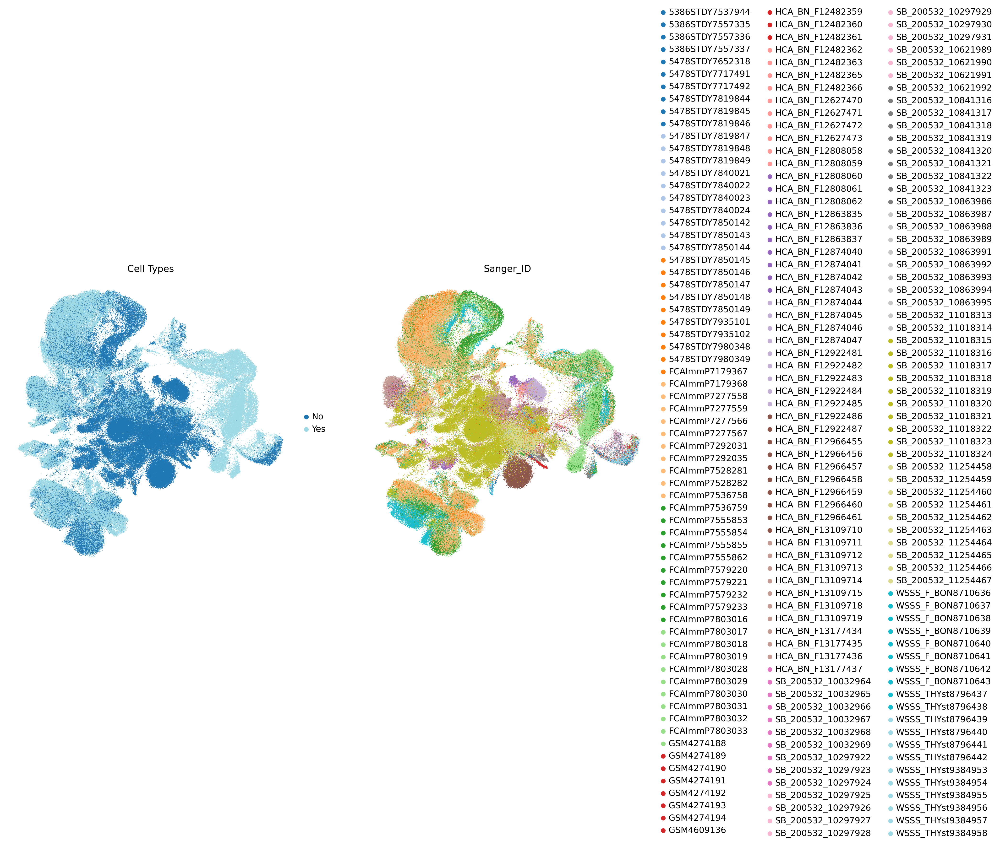

In [15]:
sc.settings.set_figure_params(figsize=(8, 8), dpi=100)  # adjust as needed

sc.pl.umap(
    adata,
    color=["immune_conf",'Sanger_ID'],
    size=3,   
    groups=[],
    # Increase point size for better visibility
    legend_loc='right margin',  # Or 'right margin' if you want a separate legend
    frameon=False,
    title='Cell Types',
    palette= 'tab20'
              # High resolution
)


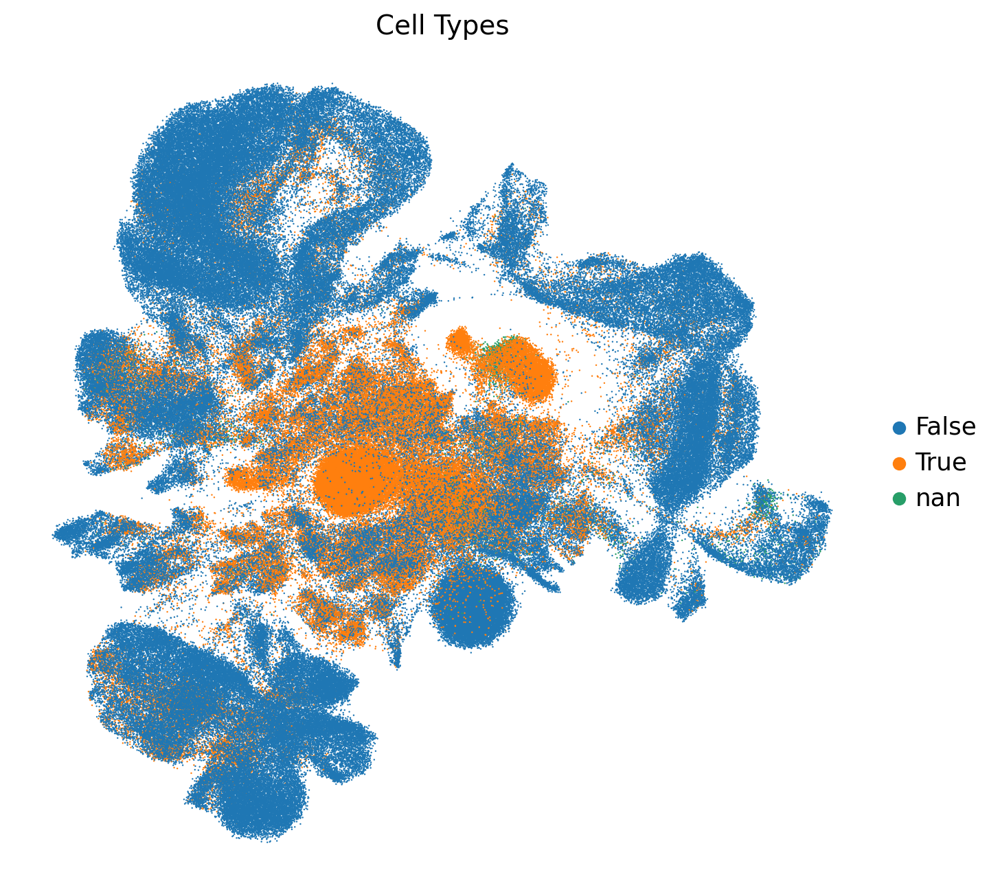

In [11]:
sc.settings.set_figure_params(figsize=(8, 8), dpi=100)  # adjust as needed

sc.pl.umap(
    adata,
    color=["predicted_doublets_unfiltered"],
    size=3,   
    groups=[],
    # Increase point size for better visibility
    legend_loc='right margin',  # Or 'right margin' if you want a separate legend
    frameon=False,
    title='Cell Types',
              # High resolution
)


# Annotate via functions 

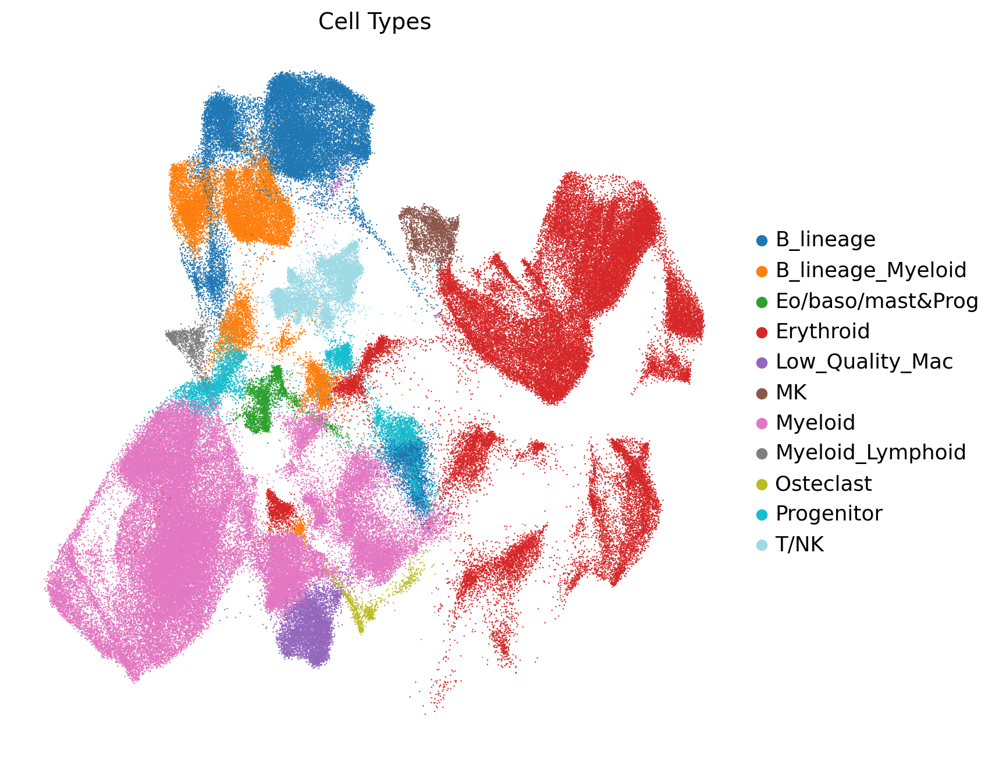

In [18]:
sc.settings.set_figure_params(figsize=(8, 8), dpi=100)  # adjust as needed

sc.pl.umap(
    module_scores,
    color=["Manual_Annotation_Level2_clean"],
    size=3,   
    groups=[],
    # Increase point size for better visibility
    legend_loc='right margin',  # Or 'right margin' if you want a separate legend
    frameon=False,
    title='Cell Types',
    palette= 'tab20'
              # High resolution
)


In [27]:
# Align obs_names between adata and module_score
common_cells = adata.obs_names.intersection(module_scores.obs_names)

# Subset adata to common cells (optional, only if you want annotation for those)
# adata = adata[common_cells].copy()

# Transfer annotation
adata.obs.loc[common_cells, "manual_anno_old"] = (
    module_scores.obs.loc[common_cells, "Manual_Annotation_Level2_clean"].values
)

# Check
print(adata.obs["manual_anno_old"].value_counts(dropna=False).head())


manual_anno_old
Non-Immune           136219
Myeloid               63982
Erythroid             53514
B_lineage             27132
B_lineage_Myeloid     16764
Name: count, dtype: int64


In [25]:
adata.obs['manual_anno_old']= "Non-Immune"
adata.obs['manual_anno_old']=adata.obs['manual_anno_old'].astype(str)

In [244]:
sc.settings.set_figure_params(figsize=(8, 8), dpi=100)  # adjust as needed

sc.pl.umap(
    adata,
    color=['leiden_res_3'],
    size=3,   
    groups=[],
    # Increase point size for better visibility
    legend_loc='right margin',  # Or 'right margin' if you want a separate legend
    frameon=False,
    title='Cell Types',
    palette= 'tab20'
              # High resolution
)


NameError: name 'adata' is not defined

# marker dicts

#  Marker Dict 

In [21]:
CATEGORY_MARKERS={'CMP': {'CD34', 'CTSG', 'PRTN3', 'SPINK2'},
 'CD14 monocyte': {'CD14', 'CD300E', 'S100A8', 'VCAN'},
 'CD4 T cell': {'AQP3', 'CD3D', 'CD40LG', 'TRAC'},
 'CD56 bright NK': {'GZMK', 'NKG7', 'PRF1', 'XCL1'},
 'CD8 T cell': {'CD3D', 'CD8A', 'CD8B', 'TRAC'},
 'DC precursor': {'CD1C', 'CD34', 'CLEC10A', 'IRF8'},
 'DC1': {'CADM1', 'CLEC9A', 'XCR1'},
 'DC2': {'CD1C', 'CLEC10A', 'FCER1A', 'HLA-DPB1'},
 'DC3': {'CD163', 'CD1C', 'CD36', 'CLEC10A', 'S100A8'},
 'ELP': {'FLT3', 'IL7R', 'LTB', 'RAG1'},
 'GMP': {'AZU1', 'CALR', 'CD34', 'PRSS57'},
 'HSC/MPP': {'CD34', 'HLF', 'MLLT3', 'PRSS57', 'SPINK2'},
 'ILC precursor': {'GATA3', 'KIT', 'RORC', 'ZBTB16'},
 'LMPP': {'BCL11A', 'CD34', 'IL2RG', 'IL7R', 'SPINK2'},
 'MEP': {'CD34', 'GATA1', 'GATA2', 'KLF1', 'PLEK'},
 'MEMP': {'CD34', 'CTNNBL1', 'GATA1', 'GATA2', 'TESPA1'},
 'MK': {'MYL9', 'PF4', 'PPBP', 'TREML1'},
 'MOP': {'IRF8', 'LYZ', 'PRTN3', 'S100A8'},
 'MPP myeloid': {'CD34', 'CSF1R', 'GATA2', 'MPO', 'SPINK2'},
 'NK T cell': {'CD8A', 'KLRB1', 'NKG7', 'TRAC'},
 'NK progenitor': {'CD34', 'NKG7', 'PRSS57', 'SOX4', 'TOX'},
 'Treg': {'CD3D', 'FOXP3', 'TIGIT', 'TRAC'},
 'adipo-CAR': {'APOE', 'CXCL12', 'GAS6', 'LPL'},
 'arteriolar fibroblast': {'BGN', 'COL3A1', 'DCN', 'SERPINF1'},
 'basophil': {'CLC', 'HDC', 'IL3RA', 'IL5RA'},
 'chondrocyte': {'COL11A1', 'COL9A3', 'HAPLN1'},
 'early MK': {'CMTM5', 'GP1BA', 'ITGA2B', 'PF4'},
 'early erythroid': {'EPCAM', 'MYC'},
 'early osteoblast': {'BGLAP', 'CPE', 'IBSP', 'IFITM5', 'OMD'},
 'endosteal fibroblast': {'BGN', 'COL3A1', 'DCN', 'SERPINF1'},
 'eo/baso/mast precursor': {'CD34', 'CSF2RB', 'HDC', 'SPINK2'},
 'eosinophil': {'CLC', 'EPX', 'HDC', 'IL5RA'},
 'erythroid macrophage': {'APOE', 'BLVRB', 'CD14', 'F13A1'},
 'immature B cell': {'CD19', 'IGHM', 'MS4A1', 'PAX5'},
 'immature EC': {'KDR', 'MRC1', 'PODXL', 'S100A10'},
 'late erythroid': {'BLVRB', 'GYPA', 'HBA1', 'PRDX2'},
 'mast cell': {'HDC', 'HPGDS', 'KIT', 'TPSAB1'},
 'mature NK': {'FCGR3A', 'GZMH', 'NKG7', 'PRF1'},
 'monocytoid macrophage': {'CD14', 'HLA-DRA', 'S100A8', 'SPP1'},
 'muscle': {'ACTA2', 'DSTN', 'SPARCL1', 'TPM2'},
 'muscle stem cell': {'ACTA2', 'DSTN', 'SPARCL1', 'TPM2'},
 'myelocyte': {'CAMP', 'CEACAM8', 'LCN2', 'LTF', 'STOM'},
 'myeloid DC progenitor': {'CD1C', 'CD34', 'CLEC10A', 'IRF8'},
 'myofibroblast': {'COL3A1', 'DES', 'MAF', 'PDLIM4'},
 'naive B cell': {'CD19', 'CD40', 'FCER2', 'IGHM', 'MS4A1'},
 'neutrophil': {'ITGAM', 'MMP9', 'ORM1', 'PGLYRP1'},
 'osteoblast': {'BGLAP', 'CPE', 'IBSP', 'IFITM5', 'OMD'},
 'osteoblast precursor': {'BGLAP', 'CPE', 'IBSP', 'IFITM5', 'OMD'},
 'osteochondral precursor': {'CD44', 'ENG', 'NT5E', 'THY1'},
 'osteoclast': {'ACP5', 'CTSK', 'MMP9'},
 'pDC': {'GZMB', 'JCHAIN', 'SERPINF1'},
 'pDC progenitor': {'CD34', 'GZMB', 'IRF8', 'JCHAIN'},
 'pre B progenitor': {'CD19', 'IGHD', 'IGHM', 'PAX5'},
 'pre pro B progenitor': {'CD19', 'EBF1', 'IL7R', 'MME', 'RAG1'},
 'pro B progenitor': {'DNTT', 'MME', 'RAG1', 'VPREB1'},
 'proliferating EC': {'KDR', 'MKI67', 'PODXL', 'RAMP2'},
 'promonocyte': {'CD14', 'CD300E', 'S100A8', 'VCAN'},
 'promyelocyte': {'AZU1', 'CTSG', 'ELANE', 'MPO', 'PRTN3'},
 'schwann cells': {'APLP1', 'CLDN11', 'CNP', 'MAG'},
 'sinusoidal EC': {'ENG', 'LYVE1', 'MRC1', 'STAB1', 'TSPAN7'},
 'stromal macrophage': {'APOE', 'C1QC', 'CD14', 'F13A1', 'SPP1'},
 'tDC': {'AXL', 'CD22', 'SIGLEC6'},
 'tip EC': {'DLL4', 'ENG', 'KDR', 'LYVE1'}}

celltypist_lymphoid= {
    "ELP": ["RUNX2", "FLT3","LTB"], # HCA Immune 2018
    'Early lymphoid/T lymphoid': ['ETS1','IL32','GATA3'], # Popescu et al. 2019
    
    "ILC_precursor": ["LST1","HPN","SCN1B"],
    "NK": ['GNLY','NKG7','XCL2'],
    "CD16+ NK": ["FCGR3A","GNLY","NKG7"],
     "CD16- NK": ["CD160","GNLY","NKG7"],
    'Trans. NK': ["CCL5","GZMK",'FCGR3A'],
    "ILC": ["S100A13",'TLE1','AREG'],
    'ILC1': ['CXCR3','CD3D','IKZF3'],
    'ILC2': ['GATA3','KLRG1','HPGDS'], 
    'ILC3': ['IL4I1','RORC','KIT'],

    


}


celltypist_progenitors=  {
    "ELP": ["RUNX2", "FLT3","LTB"], # HCA Immune 2018
    'Early lymphoid/T lymphoid': ['ETS1','IL32','GATA3'], # Popescu et al. 2019

    "HSC": ["CD34","SPINK2","CRHBP"],
    "CMP": ["MPO","CTSG","FLT3"],
    "GMP": ["ELANE","MPO","PRTN3"],
    "MEMP": ["GATA1","GATA2","ITGA2B","FCER1A"], # FCER1A, GATA1 and GATA2 liver 
    "Neut_myeloid_pro.":["SERPINB1","MPO","LYZ"]}



broad={
  "Adipose": [
    "APOE",
    "CXCL12",
    "GAS6",
    "LPL"
  ],
  "Chondrocyte": [
    "HAPLN1",
    "SOX9",
    "CNMD",
    "COL11A1",
    "COL9A1"
  ],
  "Endothelial": [
    "KDR",
    "LYVE1",
    "PECAM1",
    "CD34",
    "PODXL"
  ],
  "Neural": [
    "SOX2",
    "PAX6",
    "FOXG1",
    "OTX2",
    "SOX10"
  ],
  "Erythroid": [
    "GYPA",
    "HBA1",
    "HBE1",
    "HBZ",
    "KLF1"
  ],
  "Epidermis": [
    "KRT18",
    "KRT5",
    "MLANA",
    "PMEL",
    "TYR"
  ],
  "Epithelial": [
    "APOA1",
    "AFP",
    "DCDC2",
    "EPCAM",
    "FOXA1"
  ],
  "Fibroblast": [
    "PDGFRA",
    "BGN",
    "COL3A1",
    "DCN",
    "ECM1"
  ],
  "Lymphoid_Haem": [
    "CD19",
    "MS4A1",
    "NKG7",
    "CD8A",
    "IL7R"
  ],
  "Mesenchymal cells": [
    "RGS5",
    "PDGFRA",
    "PDPN",
    "PRRX1",
    "TAGLN"
  ],
  "Muscle": [
    "PAX7",
    "ACTA2",
    "MYOD1",
    "DSTN",
    "MYF5"
  ],
  "Myeloid_Haem": [
    "CD14",
    "CD1C",
    "CD34",
    "LYZ",
    "HLA-DRA"
  ],
  "Osteoblast": [
    "IBSP",
    "IFITM5",
    "BGLAP",
    "CPE",
    "OMD"
  ],
  "Osteoclast_Haem": [
    "ACP5",
    "MMP9",
    "CTSK",
    "ANPEP",
    "CD68"
  ],
  "Progenitor_Haem": [
    "CD34",
    "SPINK2",
    "GATA2",
    "ITGA2B",
    "MLLT3"
  ],
  "MK": [
    "ITGA2B",
    "PF4",
    "ITGB3",
    "MYL9",
    "PPBP"
  ],
  "Pan-Immune": [
    "PTPRC"
  ],
  "UNMAPPED": [
    "CD24",
    "MME"
  ]
}

#Cell Cycle genes: from Ken 

 #check cell cycle genes and regress it
s_genes = ['MCM5','PCNA','TYMS','FEN1','MCM7','MCM4','RRM1','UNG','GINS2','MCM6','CDCA7','DTL','PRIM1',
           'UHRF1','CENPU','HELLS','RFC2','POLR1B','NASP','RAD51AP1','GMNN','WDR76','SLBP','CCNE2','UBR7',
           'POLD3','MSH2','ATAD2','RAD51','RRM2','CDC45','CDC6','EXO1','TIPIN','DSCC1','BLM','CASP8AP2',
           'USP1','CLSPN','POLA1','CHAF1B','MRPL36','E2F8']
g2m_genes = ['HMGB2','CDK1','NUSAP1','UBE2C','BIRC5','TPX2','TOP2A','NDC80','CKS2','NUF2','CKS1B',
             'MKI67','TMPO','CENPF','TACC3','PIMREG','SMC4','CCNB2','CKAP2L','CKAP2','AURKB','BUB1',
             'KIF11','ANP32E','TUBB4B','GTSE1','KIF20B','HJURP','CDCA3','JPT1','CDC20','TTK','CDC25C',
             'KIF2C','RANGAP1','NCAPD2','DLGAP5','CDCA2','CDCA8','ECT2','KIF23','HMMR','AURKA','PSRC1',
             'ANLN','LBR','CKAP5','CENPE','CTCF','NEK2','G2E3','GAS2L3','CBX5','CENPA']


T_Cells= {'CD8 TRM' : ['CD8A', 'RUNX3', 'CD69', 'CD44'], 
          "CD8_cytotoxic": ["CD8A", "GZMB", "CCL5"],
        "CD8" : ["CD8A", "CD8B", "SELL"],
"Treg": ["FOXP3", "CTLA4"],
"CD4_TCM-like": ["SELL", "CCR7", "S1PR1"],
"CD4_TRM": ["CCR4", "FOXP1", "CD69"],
"CD4_Th": ["RORA", "FOXP1", "CCR4"],
"CD4_Th2": ["GATA3", "PPARG", "IL13"],
"Proliferating_TRM": ["FABP5", "MKI67"],
"CD4_Th1": ["TBX21", "STAT1"],
"CD4_Th17": ["RORC", "IL17A"],
"CD4_Th22":  ["IL21", "IL22"]}


T_cell_type_genes = {
    "EITP": ["PTPRC", "CD3G", "HOXA9", "HES1", "RORC", "CCR9", "PDCD1", "CD8A", "CD8B", "CD4", "CD40LG", "CRTAM", "ANXA1", "FOXP3", "DHRS3", "TRDC", "EOMES", "KLRD1", "TNFSF11"],
    "DN": ["PTPRC", "CD3G", "HOXA9", "HES1", "RORC", "CCR9", "PDCD1", "CD8A", "CD8B", "CD4"],
    "DP": ["PTPRC", "CD3G", "HOXA9", "HES1", "RORC", "CCR9", "PDCD1", "CD8A", "CD8B", "CD4", "CD40LG", "CRTAM", "ANXA1"],
    "αβT (entry)": ["PTPRC", "CD3G", "CD8A", "CD8B", "CD4", "CD40LG", "CRTAM", "ANXA1", "EOMES", "KLRD1"],
    "CD8+ T": ["PTPRC", "CD3G", "CD8A", "CD8B", "CD4", "CD40LG", "CRTAM", "ANXA1", "EOMES", "KLRD1"],
    "CD4+ T": ["PTPRC", "CD3G", "CD4", "CD40LG", "CRTAM", "ANXA1", "FOXP3", "DHRS3", "TRDC"],
    "CD4+ T Memory": ["PTPRC", "CD3G", "CD4", "CD40LG", "CRTAM", "ANXA1", "FOXP3", "DHRS3", "TRDC"],
    "T regulatory (Treg)": ["PTPRC", "CD3G", "CD4", "CD40LG", "ANXA1", "FOXP3", "DHRS3"],
    "γδ T": ["PTPRC", "CD3G", "TRDC", "EOMES"],
    "NK": ["PTPRC", "CD3G", "EOMES", "KLRD1"],
    "NKT": ["PTPRC", "CD3G", "CD8A", "CD8B", "CD4", "EOMES", "KLRD1"],
    "ILC": ["PTPRC", "CD3G", "RORC"],
    "B-pro/pre": ["CD19", "VPREB1", "IGHD", "IGHA1", "IGHG1"],
    "B-mature": ["CD19", "VPREB1", "IGHD", "IGHA1", "IGHG1"],
    "pDC": ["CLEC9A", "CLEC10A", "LAMP3"],
    "DC1": ["CLEC9A", "CLEC10A", "LAMP3"],
    "DC2": ["CLEC10A", "LAMP3", "LILRA4", "S100A9"],
    "Mono": ["C1QA", "TPSB2", "ITGA2B"],
    "Mac": ["C1QA", "TPSB2", "ITGA2B", "GYPA"],
    "Mast": ["TPSB2", "KIT"],
    "Ery": ["GYPA"],
    "Fibroblast": ["PDGFRA", "COL6A1", "FBN1", "RGS5", "CDH5", "LYVE1", "EPCAM"],
    "Endothelial": ["PDGFRA", "COL6A1", "FBN1", "RGS5", "CDH5", "LYVE1", "EPCAM"],
    "VSMC": ["ACTA2", "MYH11", "TAGLN"],
    "Lymph": ["PTPRC"],
    "TEC (cortical)": ["PSMB11", "DLK2", "KRT14", "KRT1", "POU2F3"],
    "TEC (medullary)": ["AIRE", "KRT1", "KRT14", "POU2F3", "MYOD1", "NEUROG1"]
}

tcell_diff_markers = {
    "T_cell_diff_markers": ["PTCRA", "TRBC1", "CD1A", "CD5", "CD4", "CD8A", "CD8B"],
    "cell_cycle": ["TOP2A", "MKI67", "PCNA"],
    "ETP": ["ID1", "ST18", "FXYD2", "DLL1"],
    "DN": ["MSI2", "HHEX", "NDST3"],
    "DP": ["ID3", "BCL11B", "SHISA6", "ELAVL4"],
    "entry": ["ROBO4", "SATB1"],
    "SP": ["CCR7", "GZMA"]
}



In [2]:
# ---- Load your broad markers built from the uploaded CSV ----
# (this is the file we created earlier when you said "use this!")
fbm_markers_path = "/nfs/team298/sm54/BoneAtlasProject/metadata/marker_genes/fbm_cell_types.sorted.json"

def load_category_markers(path=fbm_markers_path):
    with open(path) as f:
        m = json.load(f)
    # Coerce to SETS of UPPERCASE symbols for reliable set ops
    m = {str(k): {str(g).upper() for g in v} for k, v in m.items()}
    return m

CATEGORY_MARKERS = load_category_markers()

In [43]:
# (B) Auto-annotate from top-N DEGs per cluster
labels_auto, scores = annotate_broad_topN(
    adata,
    CATEGORY_MARKERS=CATEGORY_MARKERS,
    cluster_key="leiden_res_3",
    deg_key="rank_genes_groups",
    top_n=100,
    min_lfc=0.25,
    max_padj=0.05,
    min_overlap=2,
    prefer_weighted=True,
    up_only=True,
    background="markers"    # or "var"
)






In [44]:
# cluster_to_broad = { '0':'Muscle', '1':'Neural', ... }  # <- paste your dict
attach_broad_annotations(adata, labels_auto, cluster_key="leiden_res_3", out_key="Manual_FBM_ChatGPT")


/nfs/team298/sm54/BoneAtlasProject/src/annotation/annotation.py:347: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  .sort_values(by=cluster_key, key=lambda s: pd.to_numeric(s, errors="ignore")))


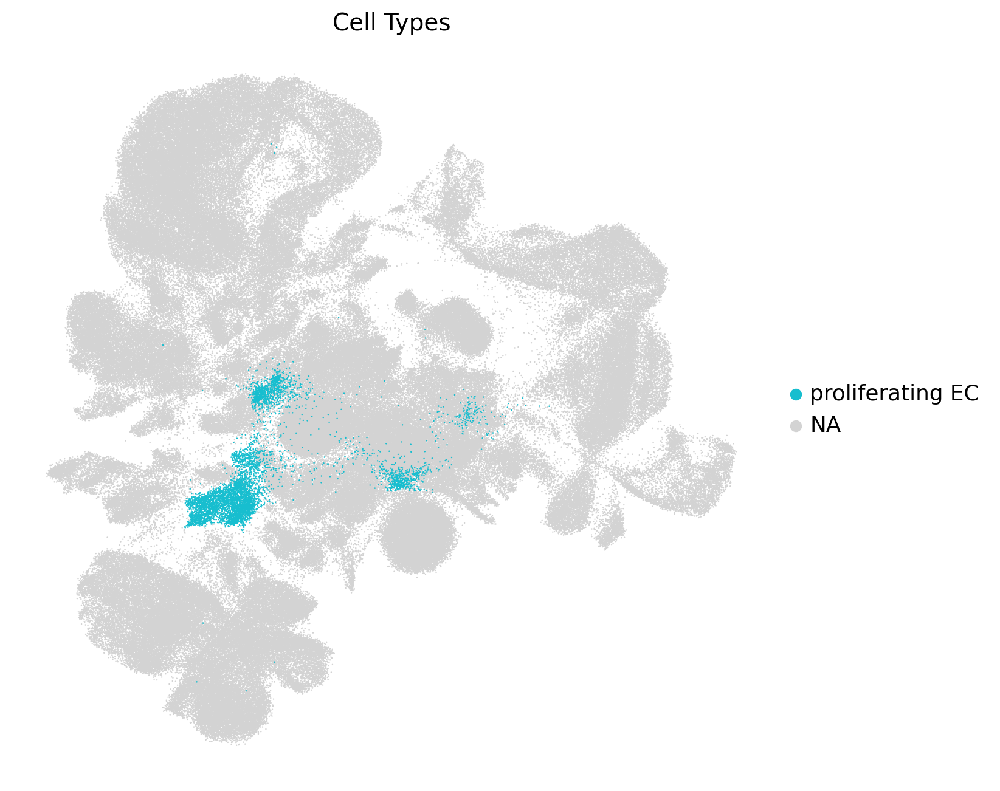

In [51]:
sc.settings.set_figure_params(figsize=(8, 8), dpi=100)  # adjust as needed

sc.pl.umap(
    adata,
    color=['Manual_FBM_ChatGPT'],
    size=3,   
    groups=['proliferating EC'],
    # Increase point size for better visibility
    legend_loc='right margin',  # Or 'right margin' if you want a separate legend
    frameon=False,
    title='Cell Types',
    palette= 'tab20'
              # High resolution
)


In [91]:
adata.obs['Manual_FBM_ChatGPT'].value_counts()

Manual_FBM_ChatGPT
late erythroid           43308
muscle                   41391
MOP                      28927
stromal macrophage       28217
promyelocyte             28053
chondrocyte              26741
pro B progenitor         26590
immature B cell          25414
Stroma                   18831
arteriolar fibroblast     9436
ELP                       6609
neutrophil                6483
proliferating EC          6134
myelocyte                 4812
NK T cell                 3971
early MK                  3628
MEP                       3591
CD56 bright NK            3067
eosinophil                2149
mast cell                 1882
pDC                       1435
osteoclast                1405
early osteoblast          1058
ILC precursor              896
Name: count, dtype: int64

In [4]:
# ---- Load your broad markers built from the uploaded CSV ----
# (this is the file we created earlier when you said "use this!")
panfetal_markers_path = "/nfs/team298/sm54/BoneAtlasProject/metadata/marker_genes/panfetal_markers.sorted.json"

def load_category_markers(path=panfetal_markers_path):
    with open(path) as f:
        m = json.load(f)
    # Coerce to SETS of UPPERCASE symbols for reliable set ops
    m = {str(k): {str(g).upper() for g in v} for k, v in m.items()}
    return m

CATEGORY_MARKERS_pf = load_category_markers()

In [93]:
# (B) Auto-annotate from top-N DEGs per cluster
labels_auto, scores = annotate_broad_topN(
    adata,
    CATEGORY_MARKERS=CATEGORY_MARKERS_pf,
    cluster_key="leiden_res_3",
    deg_key="rank_genes_groups",
    top_n=100,
    min_lfc=0.25,
    max_padj=0.05,
    min_overlap=2,
    prefer_weighted=True,
    up_only=True,
    background="markers"    # or "var"
)





In [94]:
# cluster_to_broad = { '0':'Muscle', '1':'Neural', ... }  # <- paste your dict
attach_broad_annotations(adata, labels_auto, cluster_key="leiden_res_3", out_key="Manual_PF_ChatGPT")


/nfs/team298/sm54/BoneAtlasProject/src/annotation/annotation.py:347: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  .sort_values(by=cluster_key, key=lambda s: pd.to_numeric(s, errors="ignore")))


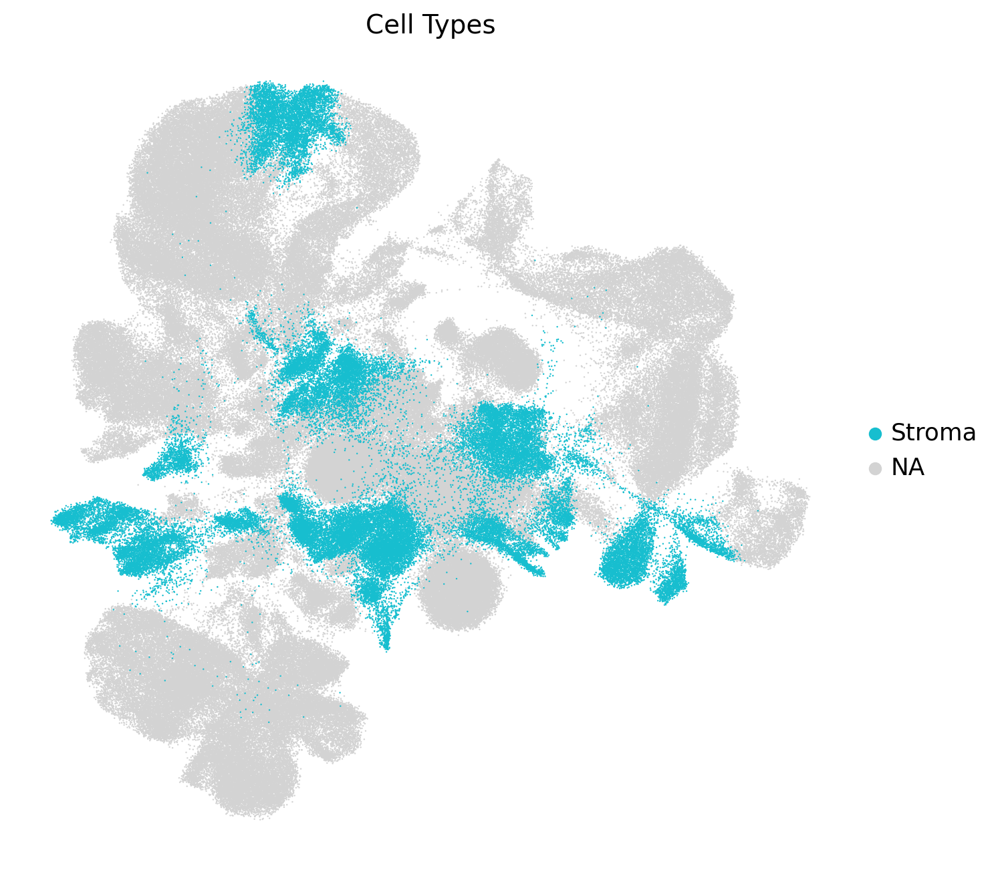

In [116]:
sc.settings.set_figure_params(figsize=(8, 8), dpi=100)  # adjust as needed

sc.pl.umap(
    adata,
    color=['Manual_PF_ChatGPT'],
    size=3,   
    groups=["Stroma"],
    # Increase point size for better visibility
    legend_loc='right margin',  # Or 'right margin' if you want a separate legend
    frameon=False,
    title='Cell Types',
    palette= 'tab20'
              # High resolution
)


In [110]:
fbm_markers = {
    'late erythroid': ['PRDX2', 'GYPA', 'HBA1', 'BLVRB'],
    'muscle': ['SPARCL1', 'DSTN', 'TPM2', 'ACTA2'],
    'MOP': ['PRTN3', 'S100A8', 'LYZ', 'IRF8'],
    'stromal macrophage': ['CD14', 'APOE', 'F13A1', 'C1QC', 'SPP1'],
    'promyelocyte': ['MPO', 'ELANE', 'CTSG', 'PRTN3', 'AZU1'],
    'chondrocyte': [ 'COL9A3', 'HAPLN1', 'COL11A1'],
    'pro B progenitor': ['DNTT', 'MME', 'VPREB1', 'RAG1'],
    'immature B cell': ['CD19', 'PAX5', 'IGHM', 'MS4A1'],
    'arteriolar fibroblast': ['DCN', 'SERPINF1', 'COL3A1', 'BGN'],
    'ELP': ['FLT3', 'IL7R', 'RAG1', 'LTB'],
    'neutrophil': ['ITGAM', 'MMP9', 'PGLYRP1', 'ORM1'],
    'proliferating EC': ['KDR', 'RAMP2', 'PODXL', 'MKI67'],
    'myelocyte': ['LCN2', 'CAMP', 'LTF', 'STOM', 'CEACAM8'],
    'NK T cell': ['CD8A', 'KLRB1', 'TRAC', 'NKG7'],
    'early MK': ['ITGA2B', 'GP1BA', 'CMTM5', 'PF4'],
    'MEP': ['CD34', 'GATA1', 'GATA2', 'KLF1', 'PLEK'],
    'CD56 bright NK': ['GZMK', 'XCL1', 'NKG7', 'PRF1'],
    'eosinophil': ['EPX', 'IL5RA', 'CLC', 'HDC'],
    'mast cell': ['KIT', 'TPSAB1', 'HPGDS', 'HDC'],
    'pDC': ['GZMB', 'JCHAIN', 'SERPINF1'],
    'osteoclast': ['ACP5', 'CTSK', 'MMP9'],
    'early osteoblast': ['IFITM5', 'CPE', 'OMD', 'BGLAP', 'IBSP'],
    'ILC precursor': ['ZBTB16', 'RORC', 'GATA3', 'KIT']
}

panfetal_markers = {
    "Stroma": ["PDGFRA"],  # from stroma_markers_panfetal["FIBROBLAST"]
    "IMMATURE": ["MME","IDH2","SPIB","IL4R","IGHM"],  # from b_markers_panfetal["PRE -> IMMATURE"]
    "VSMC/PERICYTE": ["ACTA2","TAGLN","RGS5"],  # from stroma_markers_panfetal["VSMC/PERICYTE"]
    "Late_ERY": ["GYPA", "GYPB", "SLC4A1"],  # from MEGA_ERY_markers_panfetal["Late_ERY"]
    "Myeloid_progenitor": ["PRSS57", "PRTN3", "AZU1"],  # from myeloid_markers_panfetal
    "CHONDROCYTE": ["CSPG4","COL9A1","HAPLN1"],  # from stroma_markers_panfetal
    "Monocyte_lineage": ["CD52","S100A8","MS4A6A","CD14","CXCR4","CCR2","IL1B","CD300E"],  # from myeloid_markers_panfetal
    "LATE PRO B": ["CD27","RAG1","DNTT","VPREB3"],  # from b_markers_panfetal
    "MAC_LYVE1_HIGH": ["F13A1","LYVE1","SPP1"],  # from myeloid_markers_panfetal
    "PERIVASCULAR MACROPHAGE": ["C1QA","RNASE1","LYVE1"],  # from stroma_markers_panfetal
    "Neutrophil lineage": ["ELANE","DEFA4","LCN2","LTF","ORM1"],  # from myeloid_markers_panfetal
    "SKELETAL MUSCLE": ["MYL1","ACTA1","TNNT3"],  # from stroma_markers_panfetal
    "MAC_KUPFFER_LIKE": ["ENG","KDR","CAV1"],  # from myeloid_markers_panfetal
    "Early_ERY": ["KLF1","APOE","FAM178B"],  # from MEGA_ERY_markers_panfetal
    "Mid_ERY": ["BLVRB","CD36","OAT"],  # from MEGA_ERY_markers_panfetal
    "EO_BASO_MAST": ["CLC","KIT","TPSAB1"],  # from myeloid_markers_panfetal
    "Early_MK": ["HBD","PF4"],  # from MEGA_ERY_markers_panfetal
    "MAC_MHCII_HIGH": ["HLA-DRA","HLA-DPA1","CLEC7A"],  # from myeloid_markers_panfetal
    "PLASMA B": ["JCHAIN","SDC1","CD38"],  # from b_markers_panfetal
    "OSTEOCLAST": ["MMP9","ACP5"],  # from myeloid_markers_panfetal
    "OSTEOBLAST": ["IBSP","PHOSPHO1","IFITM5"],  # from stroma_markers_panfetal
    "lymphoid progenitor": ["CD34","SPINK2","IL7R","KIT"],  # from b_markers_panfetal
    "NEURON": ["TUBB2B","STMN4","ELAVL3"]  # from stroma_markers_panfetal
}


In [63]:
sc.pp.normalize_total(adata_logged, target_sum=1e4)
sc.pp.log1p(adata_logged)

In [97]:
adata_logged.obs = adata.obs.loc[adata_logged.obs_names].copy()


In [98]:
adata_logged

AnnData object with n_obs × n_vars = 324028 × 36601
    obs: 'barcode_raw', 'Sanger_ID', 'Cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_outlier', 'gene_counts_outlier', 'mt_outlier', 'Organ', '10X_Chemistry', 'Accession_ID', 'Age', 'Age(PCW)', 'Dataset', 'Donor_ID', 'FACS_Sorting', 'Anatomical_Site', 'Method', 'Multiplexed', 'Expected_Donors', 'Organism', 'Run_ID', 'Study', 'Technology', 'predicted_labels', 'over_clustering', 'majority_voting', 'predicted_labels_Level1', 'predicted_labels_Level2', 'majority_voting_Level1', 'majority_voting_Level2', 'mt_high_outlier', 'QC', 'scrublet_score_unfiltered', 'predicted_doublets_unfiltered', 'scrublet_cluster_score_unfiltered', 'bh_pval_unf

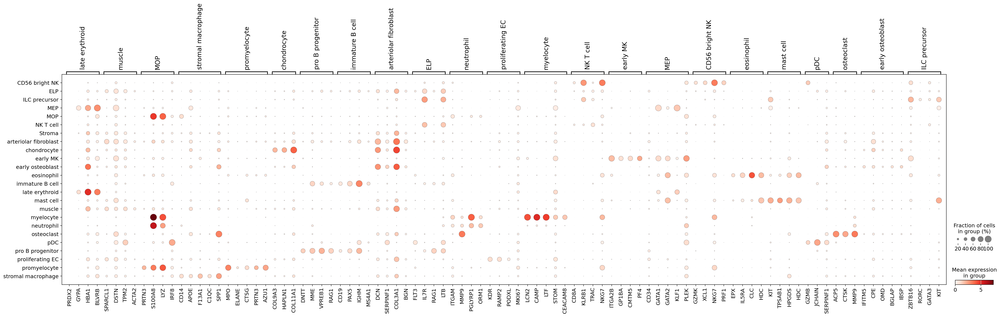

In [77]:
sc.pl.dotplot(adata_logged, var_names=dotplot_markers,groupby='Manual_FBM_ChatGPT')

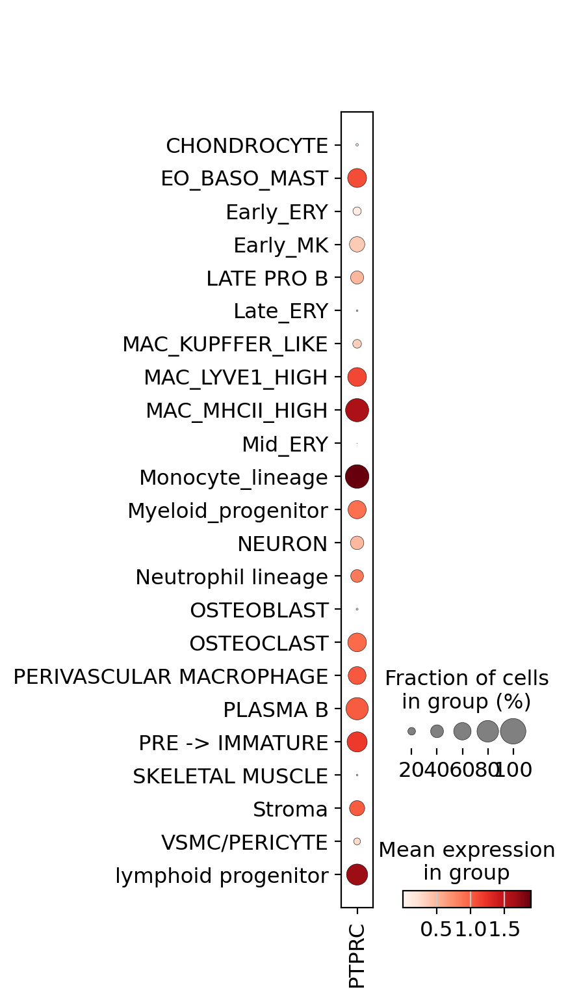

In [104]:
sc.pl.dotplot(adata_logged, var_names=["PTPRC"],groupby='Manual_PF_ChatGPT')

In [79]:
adata_logged

AnnData object with n_obs × n_vars = 324028 × 36601
    obs: 'barcode_raw', 'Sanger_ID', 'Cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_outlier', 'gene_counts_outlier', 'mt_outlier', 'Organ', '10X_Chemistry', 'Accession_ID', 'Age', 'Age(PCW)', 'Dataset', 'Donor_ID', 'FACS_Sorting', 'Anatomical_Site', 'Method', 'Multiplexed', 'Expected_Donors', 'Organism', 'Run_ID', 'Study', 'Technology', 'predicted_labels', 'over_clustering', 'majority_voting', 'predicted_labels_Level1', 'predicted_labels_Level2', 'majority_voting_Level1', 'majority_voting_Level2', 'mt_high_outlier', 'QC', 'scrublet_score_unfiltered', 'predicted_doublets_unfiltered', 'scrublet_cluster_score_unfiltered', 'bh_pval_unf

In [101]:
adata_logged.obs['Manual_PF_ChatGPT'].value_counts()

Manual_PF_ChatGPT
Stroma                     53961
PRE -> IMMATURE            37077
VSMC/PERICYTE              30525
Late_ERY                   28864
Myeloid_progenitor         25375
CHONDROCYTE                25193
Monocyte_lineage           22795
LATE PRO B                 20940
MAC_LYVE1_HIGH             18630
PERIVASCULAR MACROPHAGE    12969
Neutrophil lineage          7860
SKELETAL MUSCLE             7822
MAC_KUPFFER_LIKE            6134
Early_ERY                   4671
Mid_ERY                     4568
EO_BASO_MAST                4031
Early_MK                    3628
MAC_MHCII_HIGH              3406
PLASMA B                    1907
OSTEOCLAST                  1405
OSTEOBLAST                  1058
lymphoid progenitor          896
NEURON                       313
Name: count, dtype: int64

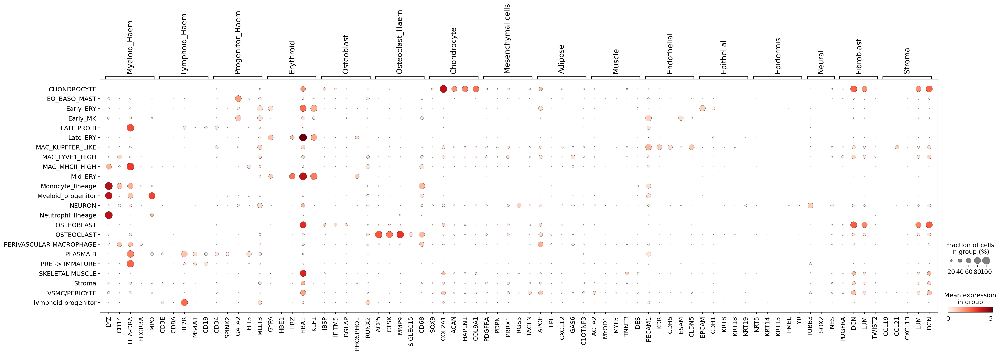

In [102]:
sc.pl.dotplot(adata_logged, var_names=marker_dictionary2,groupby='Manual_PF_ChatGPT')

In [84]:
marker_dictionary = {
  "Myeloid_Monocyte":       ["PTPRC","LYZ", "CD14", "CSF3R"],
   'Myeloid_Macrophage':  ["CD163","CD14","MRC1","C1QA","LYVE1"],
  "Lymphoid_B":      [ "IL7R", "MS4A1", "CD19","CD79A",'MME','IDH2','SPIB','IL4R','IGHM',"RAG1","DNTT"],
  "Progenitor_Haem":    ["CD34", "SPINK2", "GATA2", "FLT3", "MLLT3","HLF","MECOM"],
  "Erythroid":          ["GYPA", "HBE1", "HBZ", "HBA1", "KLF1",'SLC4A1'],
  "Osteoblast":         ["SPP1","IBSP", "IFITM5", "BGLAP", "PHOSPHO1", "RUNX2","SP7","ALPL","DMP1","SOST"],
  "Osteoclast_Haem":    ["ACP5", "CTSK", "MMP9", "SIGLEC15", "CD68"],
  "Chondrocyte":        ["SOX9", "COL2A1", "ACAN", "HAPLN1", "COL9A1"],
  "Mesenchymal cells":  ["MEIS1", "MEIS2", "MEIS3"],
  "Adipose":            ["APOE", "LPL", "CXCL12", "GAS6", "C1QTNF3"],
  "Muscle":             ["ACTA1","MYL1","ACTA2", "MYOD1", "MYF5", "TNNT3", "DES","MYH3","PAX7"],
  "Endothelial":        ["PECAM1", "KDR", "CDH5", "ESAM", "CLDN5","KITLG"],
  "Epithelial":         ["EPCAM", "CDH1", "KRT8", "KRT18", "KRT19"],
  "Epidermis":          ["KRT5", "KRT14", "KRT15", "PMEL", "TYR"],
  "Neuronal":             ["STMN2", "NES", "DCX", "ELAVL3", "TUBB3"],
      "Schwann":             ["MPZ", "MBP"],
    "Pericyte" : ['MEIS1',"MEIS2",'PDGFRA', 'TAGLN','RGS5',"FOXC2","PDGFRB", "CD248"],

  "Fibroblast":         ["PDGFRA", "DCN", "LUM", "TWIST2"],
  "Stroma":             ["CCL19", "CCL21", "CXCL13", "LUM", "DCN"],
      "Neural":             ["TUBB3", "SOX2", "NES"],
      "Mesenchymal":             ["MEIS1","MEIS2","MEIS3"],
          "OCP":             ["RUNX2","MEOX2","EYA1","SATB2", "BMP5","BMPER","SFRP1","SFRP2","FRZB","DKK2","CLEC11A","IGFBP5","EDIL3"],
   "PeriChon" :  ["THBS1","SHOX", 'PITX1' , 'TWIST2'], 
    "Neutrophil": [ "S100A8",
    "S100A9",
    "S100A12",
    "MPO",
    "AZU1",
    "PRTN3",
    "DEFA3",
    "CAMP",
    "ELANE",
    "SRGN"
], 
    "Tenocyte": ["SCX",'TNMD'],
    "Syn_Fibroblast": ["EBF2", "COL6A6", "TSHZ2", "POSTN", "TNXB"],

  "Cycling_NeuroEpth":  ["HES5", "HES6", "NNAT", "UCHL1", "KRT8", "KRT18", "FABP5"],
     "Mast/eo/ba & precursor": [ "KIT","CPA3",        #Carboxypeptidase A3
      "TPSAB1",      #// Tryptase alpha
      "TPSB2",       #// Tryptase beta
      "HDC",         #// Histidine decarboxylase
      "CLC",         #// Charcot–Leyden crystal protein
      "PRG2",        #// Major basic protein
      "HPGDS",       #// Hematopoietic PGD synthase
      "MS4A2",       #// High-affinity IgE receptor beta chain
      "FCER1G",     # // IgE receptor gamma chain
      "KIT",        # // SCF receptor (CD117)
      "SRGN",        #// Serglycin (granule proteoglycan)
      "SLC24A3",    # / Sodium/potassium/calcium exchanger
      "GATA2",       #// Mast cell TF
      "RUNX1",       #// Hematopoietic TF
      "NFE2",        #// Erythroid/mast lineage TF
      "ARHGAP15",
      "ANXA1",
      "LAPTM5"
    ],
    "LEC": ["PROX1","LYVE1","CCL21","PDPN","FLT4","STAB2","RAMP2","CALCRL","MMRN1"]
    
}


marker_dictionary2 = {
  "Myeloid_Haem":       ["LYZ", "CD14", "HLA-DRA", "FCGR3A", "MPO"],
  "Lymphoid_Haem":      ["CD3E", "CD8A", "IL7R", "MS4A1", "CD19"],
  "Progenitor_Haem":    ["CD34", "SPINK2", "GATA2", "FLT3", "MLLT3"],
  "Erythroid":          ["GYPA", "HBE1", "HBZ", "HBA1", "KLF1"],
  "Osteoblast":         ["IBSP", "IFITM5", "BGLAP", "PHOSPHO1", "RUNX2"],
  "Osteoclast_Haem":    ["ACP5", "CTSK", "MMP9", "SIGLEC15", "CD68"],
  "Chondrocyte":        ["SOX9", "COL2A1", "ACAN", "HAPLN1", "COL9A1"],
  "Mesenchymal cells":  ["PDGFRA", "PDPN", "PRRX1", "RGS5", "TAGLN"],
  "Adipose":            ["APOE", "LPL", "CXCL12", "GAS6", "C1QTNF3"],
  "Muscle":             ["ACTA2", "MYOD1", "MYF5", "TNNT3", "DES"],
  "Endothelial":        ["PECAM1", "KDR", "CDH5", "ESAM", "CLDN5"],
  "Epithelial":         ["EPCAM", "CDH1", "KRT8", "KRT18", "KRT19"],
  "Epidermis":          ["KRT5", "KRT14", "KRT15", "PMEL", "TYR"],
  "Neural":             ["SOX2", "NES", "DCX", "ELAVL3", "TUBB3"],
  "Fibroblast":         ["PDGFRA", "DCN", "LUM", "TWIST2"],
  "Stroma":             ["CCL19", "CCL21", "CXCL13", "LUM", "DCN"],
      "Neural":             ["TUBB3", "SOX2", "NES"],
}

In [88]:
CATEGORY_MARKERS_pf

{'lymphoid progenitor': {'CD34', 'IL7R', 'KIT', 'SPINK2'},
 'PRE PRO B': {'CD19', 'FLT3', 'VPREB1'},
 'PRO B': {'CDC45', 'DHFR', 'MKI67', 'MME'},
 'LATE PRO B': {'CD27', 'DNTT', 'RAG1', 'VPREB3'},
 'PRO -> PRE': {'CD24', 'TNFRSF17'},
 'PRE -> IMMATURE': {'IDH2', 'IGHM', 'IL4R', 'MME', 'SPIB'},
 'MATURE': {'CD40', 'FCER2', 'IGHD', 'MS4A1'},
 'B1': {'CCR10', 'CD27', 'SPN'},
 'PLASMA B': {'CD38', 'JCHAIN', 'SDC1'},
 'CYCLING_B': {'MKI67'},
 'Myeloid Early Progenitor': {'CD34', 'MLLT3', 'SPINK2'},
 'Myeloid_progenitor': {'AZU1', 'PRSS57', 'PRTN3'},
 'Neutrophil lineage': {'DEFA4', 'ELANE', 'LCN2', 'LTF', 'ORM1'},
 'Monocyte_lineage': {'CCR2',
  'CD14',
  'CD300E',
  'CD52',
  'CXCR4',
  'IL1B',
  'MS4A6A',
  'S100A8'},
 'DC_progenitor': {'ACY3', 'KIF17', 'TIFAB'},
 'pDC': {'CLEC4C', 'IRF7', 'JCHAIN'},
 'ASDC': {'AXL', 'SIGLEC6'},
 'DC2': {'CD1C', 'CLEC10A'},
 'DC1': {'BATF3', 'CLEC9A'},
 'MIGRATORY_DC': {'CCR7', 'LAMP3'},
 'LANGERHANS_CELLS': {'CD1A', 'CD207', 'IDO1'},
 'EO_BASO_MAST': {'C

In [105]:
adata

AnnData object with n_obs × n_vars = 324028 × 3000
    obs: 'barcode_raw', 'Sanger_ID', 'Cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_outlier', 'gene_counts_outlier', 'mt_outlier', 'Organ', '10X_Chemistry', 'Accession_ID', 'Age', 'Age(PCW)', 'Dataset', 'Donor_ID', 'FACS_Sorting', 'Anatomical_Site', 'Method', 'Multiplexed', 'Expected_Donors', 'Organism', 'Run_ID', 'Study', 'Technology', 'predicted_labels', 'over_clustering', 'majority_voting', 'predicted_labels_Level1', 'predicted_labels_Level2', 'majority_voting_Level1', 'majority_voting_Level2', 'mt_high_outlier', 'QC', 'scrublet_score_unfiltered', 'predicted_doublets_unfiltered', 'scrublet_cluster_score_unfiltered', 'bh_pval_unfi

In [106]:
# Copy selected uns keys
uns_keys_to_copy = ['X_scVI', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 
                    'leiden_res_3', 'rank_genes_groups', 'umap']

for key in uns_keys_to_copy:
    if key in adata.uns:
        adata_logged.uns[key] = adata.uns[key]

# Copy selected obsm keys
obsm_keys_to_copy = ['X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs']

for key in obsm_keys_to_copy:
    if key in adata.obsm:
        adata_logged.obsm[key] = adata.obsm[key]

# Copy selected obsp keys
obsp_keys_to_copy = ['X_scVI_connectivities', 'X_scVI_distances']

for key in obsp_keys_to_copy:
    if key in adata.obsp:
        adata_logged.obsp[key] = adata.obsp[key]


In [107]:
adata_logged

AnnData object with n_obs × n_vars = 324028 × 36601
    obs: 'barcode_raw', 'Sanger_ID', 'Cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_outlier', 'gene_counts_outlier', 'mt_outlier', 'Organ', '10X_Chemistry', 'Accession_ID', 'Age', 'Age(PCW)', 'Dataset', 'Donor_ID', 'FACS_Sorting', 'Anatomical_Site', 'Method', 'Multiplexed', 'Expected_Donors', 'Organism', 'Run_ID', 'Study', 'Technology', 'predicted_labels', 'over_clustering', 'majority_voting', 'predicted_labels_Level1', 'predicted_labels_Level2', 'majority_voting_Level1', 'majority_voting_Level2', 'mt_high_outlier', 'QC', 'scrublet_score_unfiltered', 'predicted_doublets_unfiltered', 'scrublet_cluster_score_unfiltered', 'bh_pval_unf

In [108]:
# Reindex adata_raw to match adata_logged
adata_raw_aligned = adata_raw[adata_logged.obs_names, adata_logged.var_names]

# Save as layer
adata_logged.layers["raw_counts"] = adata_raw_aligned.X.copy()


In [109]:
adata_logged

AnnData object with n_obs × n_vars = 324028 × 36601
    obs: 'barcode_raw', 'Sanger_ID', 'Cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_outlier', 'gene_counts_outlier', 'mt_outlier', 'Organ', '10X_Chemistry', 'Accession_ID', 'Age', 'Age(PCW)', 'Dataset', 'Donor_ID', 'FACS_Sorting', 'Anatomical_Site', 'Method', 'Multiplexed', 'Expected_Donors', 'Organism', 'Run_ID', 'Study', 'Technology', 'predicted_labels', 'over_clustering', 'majority_voting', 'predicted_labels_Level1', 'predicted_labels_Level2', 'majority_voting_Level1', 'majority_voting_Level2', 'mt_high_outlier', 'QC', 'scrublet_score_unfiltered', 'predicted_doublets_unfiltered', 'scrublet_cluster_score_unfiltered', 'bh_pval_unf

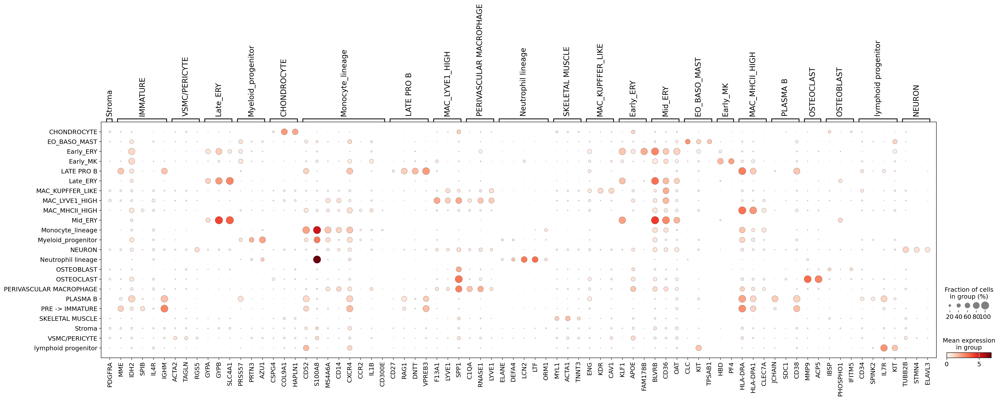

In [111]:
sc.pl.dotplot(adata_logged, var_names=panfetal_markers,groupby='Manual_PF_ChatGPT')

# DEGS Table


In [760]:
marker_genes = top_genes_for_cluster(
    adata_logged,
    cluster= '76',
    deg_key = "rank_genes_groups", 
    up_only = False,
    min_lfc = 0.25,
    max_padj = .05,
    sort_preference=("scores","logfoldchanges","pvals_adj"),
)

present_genes = []

# Iterate through the dictionary values and check if each gene appears in the DataFrame column
for cell_type, genes in marker_dict.items():
    for gene in genes:
        if gene in marker_genes['gene'].values:
            present_genes.append(gene)
# Remove duplicates while preserving order
present_genes = list(dict.fromkeys(present_genes))
# The 'present_genes' list now contains genes that are present in the DataFrame
print("Genes present in the DataFrame:", present_genes)

Genes present in the DataFrame: ['S100B', 'CRABP2', 'HLA-DRA', 'HLA-DPA1', 'PLEK', 'HAPLN1', 'LUM', 'TNC', 'CD44', 'CD74', 'HLA-DQA1', 'CNMD', 'NDUFA4L2', 'FOXP2', 'CALCRL', 'FTH1', 'DCN', 'BGN', 'COL9A3', 'COL11A1', 'TPM2', 'COL2A1', 'CCN3', 'CLU']


In [581]:
#adata_logged.obs['predicted_doublets']= adata_logged.obs['predicted_doublets'].astype(str)
#adata_logged.obs['predicted_doublets_pval']= adata_logged.obs['predicted_doublets_pval'].astype(str)

In [582]:
#adata_logged.obs['leiden_res_3_orig']=adata_logged.obs['leiden_res_3'].copy()

In [878]:
adata_logged.write_h5ad('/nfs/team298/sm54/BoneAtlasProject/data/bone_haem_compartment/bone_haem_with_annotations.h5ad')
#adata_logged=sc.read_h5ad('/nfs/team298/sm54/BoneAtlasProject/data/bone_haem_compartment/bone_haem_with_annotations.h5ad')

# Annotate 

In [4]:
Manual_Annotation= {'0': 'LOW QUALITY (MYELOID & MUSCLE)', # use propagated_anno_knn to keep the ~12000 myeloid in this cluster 
                    '1': 'LOW QUALITY', # most of the cells come from PCW 9.4 skull base and 
                    '2': 'LOW QUALITY (MUSCLE & FIBROBLAST)', # high doublet scores most cells from 12 anf 17 PCW spine 
                    '3': 'MYELOID (MONOCYTE)', # CXCR31 high and CD14 monocytes 
                    '4': 'MYELOID (MAC_LYVE1_HIGH)', # express stromal macrophage markers from the fbm paper, and LYVE1 and perivascular markers from the panfetal paper 
                    '5': 'LYMPHOID B LINEAGE (PRO B)', # pro B progenitor markers from fbm paper; cycling genes are not expressed 
                    '6': 'MYELOID (MONOCYTE & MOP)', # express CD14, amd MOP markers from fbm paper DEGS: ['S100A6', 'S100A8', 'CD14', 'LYZ', 'HLA-DRA', 'HLA-DPA1', 'BLVRB', 'CD36', 'PLEK', 'AIF1', 'STAB1', 'CD44', 'CD68', 'FTL', 'HMOX1', 'CD74', 'NKG7', 'S100A9', 'FGL2', 'CSF3R', 'S100A12', 'TNNT1', 'NRGN'
                    '7': 'MYELOID (MAC_LYVE1_HIGH)',  #express stromal macrophage markers from the fbm paper, and LYVE1 and perivascular markers from the panfetal paper;  [DEGs]: 'LYVE1', 'DKK2', 'F13A1', 'SPP1', 'RNASE1', 'MRC1', 'MITF', 'SOX6', 'MAF', 'FOXP2', 'MEIS2', 'DCN', 'COL11A1']
                    
                    '8': 'MYELOID (PROMYELOCYTE)', #  epxressed "Neut_myeloid_pro.":["SERPINB1","MPO","LYZ"] # promylocyte markers from fbm all except ELANE ['MPO', 'ELANE', 'CTSG', 'PRTN3', 'AZU1']
                    '9': 'MYELOID (PROMYELOCYTE)', # epxressed "Neut_myeloid_pro.":["SERPINB1","MPO","LYZ"] # promylocyte markers from fbm all except ELANE ['MPO', 'ELANE', 'CTSG', 'PRTN3', 'AZU1']
                    # Clustyers 8 and 9 express early myeloid lineage markers 
                    
                    '10': 'LYMPHOID B LINEAGE (PRE -> IMMATURE)_CYCLING', # express pro B, pre-B and immature B markers and s and g2m genes|
                    '11': 'ERY (MID)', # MID ERY markers from panfetal [CD36,OAT,BLVRB], also expresses KFL and GYPA, GYPB
                    '12': 'LOW QUALITY (PTPRC+ & CHONDROCYTE)', # high doublet score; cells come mostly from three lanes (knee and hip)
                    '13': 'LYMPHOID B LINEAGE (PRE B)', # doesn't express DNTT; cycling genes are not expressed 
                    '13,3': 'LYMPHOID B LINEAGE (IMMATURE B)', # subcuster expressing MS4A1
                    '14': 'LYMPHOID B LINEAGE (PRO B)_CYCLING',
                    '14,2': 'LYMPHOID B LINEAGE (IMMATURE B)', # a subcluster expresses MS4A1
                    '15': 'MYELOID (NEUTROPHIL)',  # fbm neutrophil markers are expressed by this cluster 
                    
                    '16,0': 'LOW QUALITY (FIBROBLAST)', '16,2': 'LOW QUALITY (FIBROBLAST)','16,5': 'LOW QUALITY (FIBROBLAST)',
                    '16,1': 'LOW QUALITY (ERY & FIBROBLAST)', '16,3': 'LOW QUALITY (ERY & FIBROBLAST)', '16,4': 'LOW QUALITY (ERY & FIBROBLAST)', '16,6': 'LOW QUALITY (ERY & FIBROBLAST)', 
                    '16,7': 'ERY (YS)',   '16,8': 'ERY (EARLY)',  '16,9': 'DOUBLET (ERY & OSTEOBLAST)', # panfetal osteoblast markers 
                    
                    '17': 'ERY (MID -> LATE)',
                    '18': 'LYMPHOID B LINEAGE (PRE -> IMMATURE)(?)', # A low expression of MME and co-expresison of pre and immautre B genes though very high expression of MS4A1; CYCLING GENES ARE NOT EXPRSSED
                    
                    '19': 'MYELOID (MAC_ERY)/MYELOID (MAC_PERIVASCULAR)', # expressiono of erythroid macrophage markers from the fbm paper; also has high expression of perivasuclar mac marker form panfetal paper 
                    
                    '20': 'LYMPHOID B LINEAGE (PRO -> PRE)', # tricky to annotate as one cell type. epxressed MME (pro B marker) but also pre-immature B markers (panfetal) bu no MS4A1 so 
                    "21": "LOW QUALITY (PRE/PRO B & FIBROBLAST)", '21,2': "LOW QUALITY (IMMATURE B & MUSCLE)",'21,6': 'MUSCLE',
                    
                    '22': 'HSC_MPP & GMP & CMP & PROMYELOCYTE',  # express GMP, CMP, HSC_MPP and myelocyte markers from fbm 
                    '23': 'MYELOID (NEUTROPHIL & MYELOCYTE)',# express neutrophil and myelocyte markers from fbm and neutrophil lineage markers from panfetal 
                    '24': 'ERY (MID -> LATE) / LATE', # expression of GYPA increased gradually across subclusters 
                    '25': 'LOW QUALITY (MUSCLE)', # 1000 out of 3000 cells are doublets in this cluster 
                    '26': 'ERY (LATE)',# higher expression of GYPA 
                    '27': 'LYMPHOID B LINEAGE (PRO B)', # cycling genes are not expressed 
                    '28': 'ERY (MID -> LATE) / LATE',  '28,0': 'ERY (MID -> LATE) / LATE_CYCLING',  '28': 'ERY (MID -> LATE) / LATE_CYCLING', 
                    '29': 'ERY (LATE)_firsttrimester', # this cluster is mostly cells from the first trimester 
                    '30': 'LOW QUALITY (MYELOCYTE+ & MUSCLE)', # 3000/4000 of this cluster is labelled as doublets; expressed PTPRC, S100A8, ELANE, LYZ and then muscle and fibroblast markers 
                    '31': 'ENDOTHELIAL KDR+MRC1+PECAM1+', # high doublet numebrs 2000/3000
                    '32': 'LYMPHOID T LINEAGE (DN)', # T Cells expressing "PTPRC","CD3G","CD3E","BCL11B","CD7","IL7R","LTB"; 
                    # Cluster 32: double negative (CD4-CD8-) as don't express "CD8A","CD8B","CD4"; no expression of RAG; low expression of innate lymphocyte markers"KLRB1",'ZBTB16'
                    
                    '33,1': 'PROGENITOR (ERY & MK)', '33,2': 'PROGENITOR (ERY & MK)', '33,3': 'PROGENITOR (ERY & MK)', 
                    # clusters 33,1; to 33,3: Express panfetal markers TESPA1,GATA2,FCER1A; express PRSS57; express MEMP markers from FBM ('GATA1', 'GATA2', 'TESPA1', 'CTNNBL1') also express PF4,ITG2AB
                    '33,0': 'MK (EARLY)',  '33,4': "MK (EARLY)",   '33,5': "MK (EARLY)",   '33,7': "MK (EARLY)",  # PF4,ITG2AB; don't express TESPA1,GATA2,FCER1A;
                    '33,6': "LOW QUALITY (MK)", '33,8': 'LOW QUALITY (LYMPHOID B LINEAGE (PRO B) & MAST)',

                    
                    '34': 'ERY (EARLY)_CYCLING', # express PRSS57, GATA1, KLF1; some MEP markers from fbm, early erythoid markers from panfetal 
                    '35':'LYMPHOID T LINEAGE (EARLY DN & NK) & MUSCLE DOUBLETS', # express "IL7R","LTB","CD3G","CD3E","BCL11B","CD7",
                    '35,2': 'PROGENITOR (LYMPHOID)', # expressed CD34, IL7R,LTB,NKG7,CD3E,
                    # CLUSTER 35: 5,6 subclusters experess chondrocute and muscle markers; sucluster 4 exprss pericyte markersl all subcluetrs express PTPRC; high doublet scores >60 doubelts in clusyer; PCW 17 spine majority 
                    
                    '36,2': 'LYMPHOID B LINEAGE (IMMATURE B) & MUSCLE DOUBLETS', # expresses MS4A1  
                    '36,0': 'LYMPHOID B LINEAGE (PRO B) & MUSCLE DOUBLETS','36,1': 'LYMPHOID B LINEAGE (PRO B) & MUSCLE DOUBLETS',
                    '36,4': 'LYMPHOID B LINEAGE (PRO B) & MUSCLE DOUBLETS', # RAG,MME,VPREB1 
                     '36,5': 'LYMPHOID B LINEAGE (PRO B) & MUSCLE DOUBLETS', # RAG,MME,VPREB1 
                    '36,3': 'LYMPHOID B LINEAGE (IMMATURE B) & MUSCLE DOUBLETS','36,6': 'LYMPHOID B LINEAGE (IMMATURE B) & MUSCLE DOUBLETS', # expresses MS4A1 but lower than 36,2
                    '36,7': 'PROGENITOR (pDC)', # pDC progneitor markers from FBM 
                    # cluster 36 has high doubelt ratio 2000/3500 are doublets; moderate expression of cycling genes 
                    
                    '37': 'ERY (MID -> LATE)', 
                    '38': 'MYELOID (MAC_ERY)/MYELOID (MAC_PERIVASCULAR) & MUSCLE DOUBLETS', # high doublets and most of PCW 17 spine 
                    
                    '39,0': 'LYMPHOID B LINEAGE (PRE B)',
                    '39,1': 'LYMPHOID B LINEAGE (PRO B)','39,2': 'LYMPHOID B LINEAGE (PRO B)', # RAG1 expresedd 
                    '39,3': 'LYMPHOID B LINEAGE (IMMATURE B)', '39,4': 'LYMPHOID B LINEAGE (IMMATURE B)', 
                    '39,5': 'LYMPHOID B LINEAGE (IMMATURE B)', # MS4a1
                    # cluster 39 has no expression of cycling genes 

                    '40,0': 'MYELOID (DC)',  '40,2': 'MYELOID (DC)', '40,3': 'MYELOID (DC)', '40,4': 'MYELOID (DC)',# DC MARKERS FROM FBM IRF8; 
                    '40,1': 'MYELOID (MAC_ERY)/MYELOID (MAC_PERIVASCULAR)','40,7': 'MYELOID (MAC_ERY)/MYELOID (MAC_PERIVASCULAR)', # CD34, MECOM, HOXA9,MPO
                    '40,5': 'PROGENITOR (CMP)', # CD34, MECOM, HOXA9; CMP MARKERS FROM FBM
                    '40,6': 'MYELOID (DC_PROLIFERATING)', # DC MARKERS FROM FBM 
                    
                    '41,0': 'LYMPHOID (NK)',   '41,6': 'LYMPHOID T LINEAGE (CD8)',   
                    '41,1': 'LYMPHOID (NK)', '41,2': 'LYMPHOID (NK)', '41,3': 'LYMPHOID (NK)', 
                    '41,4': ' LYMPHOID (ILCP)', '41,5': 'LYMPHOID T LINEAGE (CD8)', 
                    '41,7': 'LYMPHOID B LINEAGE (PRO B) & LYMPHOID T LINEAGE (CD8)',
                    
                    '42,0': 'PROGENITOR (PROMYELOCYTE)', '42,4': 'PROGENITOR (PROMYELOCYTE)', '42,5': 'PROGENITOR (PROMYELOCYTE)',
                    '42,6': 'PROGENITOR (PROMYELOCYTE)', '42,7': 'PROGENITOR (PROMYELOCYTE)', '42,8': 'PROGENITOR (PROMYELOCYTE)', 
                    '42,1': 'PROGENITOR (MYELOCYTE)', '42,2': 'PROGENITOR (MYELOCYTE)', '42,3': 'PROGENITOR (MYELOCYTE)',

                    '43':'LYMPHOID B LINEAGE (PRE -> IMMATURE) & SCHWANN DOUBLETS', # Cycling genes are not expressed 
                    '43,3': 'LYMPHOID B LINEAGE (IMMATURE B) & SCHWANN DOUBLETS',
                    '43,7': 'LYMPHOID T LINEAGE (DP)', 
                    
                    '44,0': 'ERY (MID -> LATE)', '44,3': '(MID -> LATE)', '44,4': '(MID -> LATE)',
                    '44,1': 'PROGENITOR', '44,5': 'PROGENITOR', '44,2': 'MUSCLE', '44,6': 'MUSLCE',
                    
                    '45': 'FIBROBLAST',
                    
                    '46,0': 'CHONDROCTYE', '46,4': 'CHONDROCTYE', # 
                    '46,1': 'PROGENITOR', '46,3': 'PROGENITOR', '46,7': 'PROGENITOR', # express CD34 and PTPRC and KIT
                    '46,2': 'ERY (LATE)', '46,5': 'ERY (LATE)', '46,6': 'ERY (LATE)', # 

                    
                    '47': 'LYMPHOID B LINEAGE (PRE -> IMMATURE B_CYCLING) & MYELOID (MOP) & NEURAL (SCHWANN) DOUBLETS',
                     '48,0': 'MYELOID (MAC_PERIVASCULAR) & ENDOTHELIAL DOUBLETS', '48,1': 'LOW QUALITY',
                    '48,2': 'LYMPHOID B LINEAGE (PRE -> IMMATURE B)',
                    '48,3': 'PROGENITOR (CMP)', '48,4': 'ERY (LATE)', 
                   '49': 'MYELOID (MONOCYTE)',   '49,2': 'PROGENITOR (MOP)', 
                    '50,0': 'MYELOID (MONOCYTE)', '50,1': 'PROGENITOR (MYELOCYTE)', '50,2': 'PROGENITOR (PROMYELOCYTE)',
                    '50,3': 'MYELOID (MONOCYTE)', '50,4': 'PROGENITOR (PROMYELOCYTE)', # fbm markers MPO and AZU1  
                   '51,0':"(MAC_LYVE1_HIGH)",  '51,1':"(MAC_LYVE1_HIGH)",'51,2': 'MYELOID (MAC_LYVE1_HIGH) & LYMPHOID (IMMATURE B)? DOUBLETS', 
                    '51,3':"MYELOID (MONOCYTE)",  '51,4':"MYELOID (MAC_MHCII_HIGH)", '51,5':"MYELOID (MAC_LYVE1_HIGH)",
                    
                    '52': 'MYELOID (BASOPHIL/EOSINOPHIL)', '53': 'PROGENITOR (MOP) (HIGH DOUBLETS)',
                    '54': 'FIBROBALST',  '54,4': 'ERY (LATE & YS)', 
                    
                    '55,0': 'PROGENITOR (LMPP) & IMMATURE B DOUBLETS', '55,1': 'LYMPHOID B LINEAGE (IMMATURE B)',  
                    '55,2': 'PROGENITOR (LMPP) CYCLING & IMMATURE B DOUBLETS', 
                    '55,3':'LYMPHOID B LINEAGE (PRO B)', # Cyclong genes re also exprrsse din sub clusyers 0 an 1 to a lower degree 

                    
                    '56,0': 'PROGENITOR (MEMP)','56': "MAST",
                   '57':'FIBROBLAST', '57,0': 'ERY (LATE & YS)',  '57,4': 'ERY (LATE & YS)', 
                    
                    '58,0': 'LYMPHOID B LINEAGE (PRE -> IMMATURE)', '58,1': "MYELOID (MAC_PERIVASCULAR)",'58,2': "ERY (LATE)",
                    '58,3': "MUSCLE",'58,4': "MUSCLE", # most form PCW17 SPINE with hig doublet ratio
                    '59,0': 'MYELOID (pDC)','59,1': 'MYELOID (pDC)', # fbm markers 
                     '59,2': 'PROGENITOR (pDC)', '59,3': 'PROGENITOR (pDC)', # panfetal markers 
                    '59,4': 'MYELOID (MONOCYTE)',
                    '60,0': 'MYELOID (MAC_MHCII_HIGH)','60,1': 'MYELOID (MAC_MHCII_HIGH)','60,3': 'MYELOID (MAC_MHCII_HIGH) & IMMATURE B DOUBLETS', # also expresses FBM MARKERS FOR STROMAL MAC |
                    '60,2': 'MYELOID (MICROGLIA)', 
                    '61': 'MYELOID (OSTEOCLAST)', '62': 'CHONDROCYTE',
                    
                    '63': 'LYMPHOID T LINEAGE (EARLY DN)','63,2': 'LYMPHOID (NK)', '64': 'ERY (LATE)', '65': 'ERY (EARLY -> MID)',
                    '66': 'PROGENITOR (PROMYELOCYTE) & SCHWANN DOUBLETS', '67': 'OSTEOBLAST', '68': 'PROGENITOR (ILCP)',
                    '69': 'MYELOID (MONOCYTE) & MUSCLE DOUBLETS', '69,3': 'MYELOID (MONOCYTE)',
                    
                    '70,0': 'ERY & IMMUNE DOUBLET', '70,1':'PROGENITOR (CMP)',
                    '70,2':'PROGENITOR (MYELOCYTE)','70,3':'PROGENITOR (MYELOCYTE)',
                    '71': 'ERY (LATE) & SCHWANN DOUBLETS',
                     '72,0': 'LYMPHOID B LINEAGE (PRO B)_CYCLING & ERY (EARLY) DOUBLETS','72,1': 'LYMPHOID B LINEAGE (PRO B)_CYCLING & ERY (EARLY) DOUBLETS',
                    '72,2': 'LYMPHOID B LINEAGE (IMMATURE B) & ERY (LATE) DOUBLETS', '72,3': 'LYMPHOID B LINEAGE (PRO B) &  ERY (LATE) DOUBLETS', 
                    
                    '73,0': 'PROGENITOR (PROMYELOCYTE/ EARLY MK)',  '73,1': 'FIBROBLAST',  '73,2': 'FIBROBLAST', 
                   
                    "73,3": 'LYMPHOID B LINEAGE (PRE B)',
                    '74,0': 'MYELOID (MAC_LYVE1_HIGH)','74,2': 'ERY (LATE & YS)',
                    '74,3': 'MYELOID (MAC_LYVE1_HIGH)','74,1': 'NEURAL (SCHWANN)','74,4': 'NEURAL (SCHWANN)',
                    '75,0': 'LYMPHOID (NK) & MYELOID (MONOCYTE) DOUBLETS','75,1': 'MYELOID (MONOCYTE)',
                    '75,2': 'LYMPHOID T LINEAGE (CD8) & MYELOID (MONOCYTE) DOUBLETS', 
                    '76': 'MYELOID (MAC_MHCII_HIGH)'}


In [9]:
import re, json, os
raw= r"""
Manual_Annotation= {'0': 'LOW QUALITY (MYELOID & MUSCLE)', # use propagated_anno_knn to keep the ~12000 myeloid in this cluster 
                    '1': 'LOW QUALITY', # most of the cells come from PCW 9.4 skull base and 
                    '2': 'LOW QUALITY (MUSCLE & FIBROBLAST)', # high doublet scores most cells from 12 anf 17 PCW spine 
                    '3': 'MYELOID (MONOCYTE)', # CXCR31 high and CD14 monocytes 
                    '4': 'MYELOID (MAC_LYVE1_HIGH)', # express stromal macrophage markers from the fbm paper, and LYVE1 and perivascular markers from the panfetal paper 
                    '5': 'LYMPHOID B LINEAGE (PRO B)', # pro B progenitor markers from fbm paper; cycling genes are not expressed 
                    '6': 'MYELOID (MONOCYTE & MOP)', # express CD14, amd MOP markers from fbm paper DEGS: ['S100A6', 'S100A8', 'CD14', 'LYZ', 'HLA-DRA', 'HLA-DPA1', 'BLVRB', 'CD36', 'PLEK', 'AIF1', 'STAB1', 'CD44', 'CD68', 'FTL', 'HMOX1', 'CD74', 'NKG7', 'S100A9', 'FGL2', 'CSF3R', 'S100A12', 'TNNT1', 'NRGN'
                    '7': 'MYELOID (MAC_LYVE1_HIGH)',  #express stromal macrophage markers from the fbm paper, and LYVE1 and perivascular markers from the panfetal paper;  [DEGs]: 'LYVE1', 'DKK2', 'F13A1', 'SPP1', 'RNASE1', 'MRC1', 'MITF', 'SOX6', 'MAF', 'FOXP2', 'MEIS2', 'DCN', 'COL11A1']
                    
                    '8': 'MYELOID (PROMYELOCYTE)', #  epxressed "Neut_myeloid_pro.":["SERPINB1","MPO","LYZ"] # promylocyte markers from fbm all except ELANE ['MPO', 'ELANE', 'CTSG', 'PRTN3', 'AZU1']
                    '9': 'MYELOID (PROMYELOCYTE)', # epxressed "Neut_myeloid_pro.":["SERPINB1","MPO","LYZ"] # promylocyte markers from fbm all except ELANE ['MPO', 'ELANE', 'CTSG', 'PRTN3', 'AZU1']
                    # Clustyers 8 and 9 express early myeloid lineage markers 
                    
                    '10': 'LYMPHOID B LINEAGE (PRE -> IMMATURE)_CYCLING', # express pro B, pre-B and immature B markers and s and g2m genes|
                    '11': 'ERY (MID)', # MID ERY markers from panfetal [CD36,OAT,BLVRB], also expresses KFL and GYPA, GYPB
                    '12': 'LOW QUALITY (PTPRC+ & CHONDROCYTE)', # high doublet score; cells come mostly from three lanes (knee and hip)
                    '13': 'LYMPHOID B LINEAGE (PRE B)', # doesn't express DNTT; cycling genes are not expressed 
                    '13,3': 'LYMPHOID B LINEAGE (IMMATURE B)', # subcuster expressing MS4A1
                    '14': 'LYMPHOID B LINEAGE (PRO B)_CYCLING',
                    '14,2': 'LYMPHOID B LINEAGE (IMMATURE B)', # a subcluster expresses MS4A1
                    '15': 'MYELOID (NEUTROPHIL)',  # fbm neutrophil markers are expressed by this cluster 
                    
                    '16,0': 'LOW QUALITY (FIBROBLAST)', '16,2': 'LOW QUALITY (FIBROBLAST)','16,5': 'LOW QUALITY (FIBROBLAST)',
                    '16,1': 'LOW QUALITY (ERY & FIBROBLAST)', '16,3': 'LOW QUALITY (ERY & FIBROBLAST)', '16,4': 'LOW QUALITY (ERY & FIBROBLAST)', '16,6': 'LOW QUALITY (ERY & FIBROBLAST)', 
                    '16,7': 'ERY (YS)',   '16,8': 'ERY (EARLY)',  '16,9': 'DOUBLET (ERY & OSTEOBLAST)', # panfetal osteoblast markers 
                    
                    '17': 'ERY (MID -> LATE)',
                    '18': 'LYMPHOID B LINEAGE (PRE -> IMMATURE)(?)', # A low expression of MME and co-expresison of pre and immautre B genes though very high expression of MS4A1; CYCLING GENES ARE NOT EXPRSSED
                    
                    '19': 'MYELOID (MAC_ERY)/MYELOID (MAC_PERIVASCULAR)', # expressiono of erythroid macrophage markers from the fbm paper; also has high expression of perivasuclar mac marker form panfetal paper 
                    
                    '20': 'LYMPHOID B LINEAGE (PRO -> PRE)', # tricky to annotate as one cell type. epxressed MME (pro B marker) but also pre-immature B markers (panfetal) bu no MS4A1 so 
                    "21": "LOW QUALITY (PRE/PRO B & FIBROBLAST)", '21,2': "LOW QUALITY (IMMATURE B & MUSCLE)",'21,6': 'MUSCLE',
                    
                    '22': 'HSC_MPP & GMP & CMP & PROMYELOCYTE',  # express GMP, CMP, HSC_MPP and myelocyte markers from fbm 
                    '23': 'MYELOID (NEUTROPHIL & MYELOCYTE)',# express neutrophil and myelocyte markers from fbm and neutrophil lineage markers from panfetal 
                    '24': 'ERY (MID -> LATE) / LATE', # expression of GYPA increased gradually across subclusters 
                    '25': 'LOW QUALITY (MUSCLE)', # 1000 out of 3000 cells are doublets in this cluster 
                    '26': 'ERY (LATE)',# higher expression of GYPA 
                    '27': 'LYMPHOID B LINEAGE (PRO B)', # cycling genes are not expressed 
                    '28': 'ERY (MID -> LATE) / LATE',  '28,0': 'ERY (MID -> LATE) / LATE_CYCLING',  '28': 'ERY (MID -> LATE) / LATE_CYCLING', 
                    '29': 'ERY (LATE)_firsttrimester', # this cluster is mostly cells from the first trimester 
                    '30': 'LOW QUALITY (MYELOCYTE+ & MUSCLE)', # 3000/4000 of this cluster is labelled as doublets; expressed PTPRC, S100A8, ELANE, LYZ and then muscle and fibroblast markers 
                    '31': 'ENDOTHELIAL KDR+MRC1+PECAM1+', # high doublet numebrs 2000/3000
                    '32': 'LYMPHOID T LINEAGE (DN)', # T Cells expressing "PTPRC","CD3G","CD3E","BCL11B","CD7","IL7R","LTB"; 
                    # Cluster 32: double negative (CD4-CD8-) as don't express "CD8A","CD8B","CD4"; no expression of RAG; low expression of innate lymphocyte markers"KLRB1",'ZBTB16'
                    
                    '33,1': 'PROGENITOR (ERY & MK)', '33,2': 'PROGENITOR (ERY & MK)', '33,3': 'PROGENITOR (ERY & MK)', 
                    # clusters 33,1; to 33,3: Express panfetal markers TESPA1,GATA2,FCER1A; express PRSS57; express MEMP markers from FBM ('GATA1', 'GATA2', 'TESPA1', 'CTNNBL1') also express PF4,ITG2AB
                    '33,0': 'MK (EARLY)',  '33,4': "MK (EARLY)",   '33,5': "MK (EARLY)",   '33,7': "MK (EARLY)",  # PF4,ITG2AB; don't express TESPA1,GATA2,FCER1A;
                    '33,6': "LOW QUALITY (MK)", '33,8': 'LOW QUALITY (LYMPHOID B LINEAGE (PRO B) & MAST)',

                    
                    '34': 'ERY (EARLY)_CYCLING', # express PRSS57, GATA1, KLF1; some MEP markers from fbm, early erythoid markers from panfetal 
                    '35':'LYMPHOID T LINEAGE (EARLY DN & NK) & MUSCLE DOUBLETS', # express "IL7R","LTB","CD3G","CD3E","BCL11B","CD7",
                    '35,2': 'PROGENITOR (LYMPHOID)', # expressed CD34, IL7R,LTB,NKG7,CD3E,
                    # CLUSTER 35: 5,6 subclusters experess chondrocute and muscle markers; sucluster 4 exprss pericyte markersl all subcluetrs express PTPRC; high doublet scores >60 doubelts in clusyer; PCW 17 spine majority 
                    
                    '36,2': 'LYMPHOID B LINEAGE (IMMATURE B) & MUSCLE DOUBLETS', # expresses MS4A1  
                    '36,0': 'LYMPHOID B LINEAGE (PRO B) & MUSCLE DOUBLETS','36,1': 'LYMPHOID B LINEAGE (PRO B) & MUSCLE DOUBLETS',
                    '36,4': 'LYMPHOID B LINEAGE (PRO B) & MUSCLE DOUBLETS', # RAG,MME,VPREB1 
                     '36,5': 'LYMPHOID B LINEAGE (PRO B) & MUSCLE DOUBLETS', # RAG,MME,VPREB1 
                    '36,3': 'LYMPHOID B LINEAGE (IMMATURE B) & MUSCLE DOUBLETS','36,6': 'LYMPHOID B LINEAGE (IMMATURE B) & MUSCLE DOUBLETS', # expresses MS4A1 but lower than 36,2
                    '36,7': 'PROGENITOR (pDC)', # pDC progneitor markers from FBM 
                    # cluster 36 has high doubelt ratio 2000/3500 are doublets; moderate expression of cycling genes 
                    
                    '37': 'ERY (MID -> LATE)', 
                    '38': 'MYELOID (MAC_ERY)/MYELOID (MAC_PERIVASCULAR) & MUSCLE DOUBLETS', # high doublets and most of PCW 17 spine 
                    
                    '39,0': 'LYMPHOID B LINEAGE (PRE B)',
                    '39,1': 'LYMPHOID B LINEAGE (PRO B)','39,2': 'LYMPHOID B LINEAGE (PRO B)', # RAG1 expresedd 
                    '39,3': 'LYMPHOID B LINEAGE (IMMATURE B)', '39,4': 'LYMPHOID B LINEAGE (IMMATURE B)', 
                    '39,5': 'LYMPHOID B LINEAGE (IMMATURE B)', # MS4a1
                    # cluster 39 has no expression of cycling genes 

                    '40,0': 'MYELOID (DC)',  '40,2': 'MYELOID (DC)', '40,3': 'MYELOID (DC)', '40,4': 'MYELOID (DC)',# DC MARKERS FROM FBM IRF8; 
                    '40,1': 'MYELOID (MAC_ERY)/MYELOID (MAC_PERIVASCULAR)','40,7': 'MYELOID (MAC_ERY)/MYELOID (MAC_PERIVASCULAR)', # CD34, MECOM, HOXA9,MPO
                    '40,5': 'PROGENITOR (CMP)', # CD34, MECOM, HOXA9; CMP MARKERS FROM FBM
                    '40,6': 'MYELOID (DC_PROLIFERATING)', # DC MARKERS FROM FBM 
                    
                    '41,0': 'LYMPHOID (NK)',   '41,6': 'LYMPHOID T LINEAGE (CD8)',   
                    '41,1': 'LYMPHOID (NK)', '41,2': 'LYMPHOID (NK)', '41,3': 'LYMPHOID (NK)', 
                    '41,4': ' LYMPHOID (ILCP)', '41,5': 'LYMPHOID T LINEAGE (CD8)', 
                    '41,7': 'LYMPHOID B LINEAGE (PRO B) & LYMPHOID T LINEAGE (CD8)',
                    
                    '42,0': 'PROGENITOR (PROMYELOCYTE)', '42,4': 'PROGENITOR (PROMYELOCYTE)', '42,5': 'PROGENITOR (PROMYELOCYTE)',
                    '42,6': 'PROGENITOR (PROMYELOCYTE)', '42,7': 'PROGENITOR (PROMYELOCYTE)', '42,8': 'PROGENITOR (PROMYELOCYTE)', 
                    '42,1': 'PROGENITOR (MYELOCYTE)', '42,2': 'PROGENITOR (MYELOCYTE)', '42,3': 'PROGENITOR (MYELOCYTE)',

                    '43':'LYMPHOID B LINEAGE (PRE -> IMMATURE) & SCHWANN DOUBLETS', # Cycling genes are not expressed 
                    '43,3': 'LYMPHOID B LINEAGE (IMMATURE B) & SCHWANN DOUBLETS',
                    '43,7': 'LYMPHOID T LINEAGE (DP)', 
                    
                    '44,0': 'ERY (MID -> LATE)', '44,3': '(MID -> LATE)', '44,4': '(MID -> LATE)',
                    '44,1': 'PROGENITOR', '44,5': 'PROGENITOR', '44,2': 'MUSCLE', '44,6': 'MUSLCE',
                    
                    '45': 'FIBROBLAST',
                    
                    '46,0': 'CHONDROCTYE', '46,4': 'CHONDROCTYE', # 
                    '46,1': 'PROGENITOR', '46,3': 'PROGENITOR', '46,7': 'PROGENITOR', # express CD34 and PTPRC and KIT
                    '46,2': 'ERY (LATE)', '46,5': 'ERY (LATE)', '46,6': 'ERY (LATE)', # 

                    
                    '47': 'LYMPHOID B LINEAGE (PRE -> IMMATURE B_CYCLING) & MYELOID (MOP) & NEURAL (SCHWANN) DOUBLETS',
                     '48,0': 'MYELOID (MAC_PERIVASCULAR) & ENDOTHELIAL DOUBLETS', '48,1': 'LOW QUALITY',
                    '48,2': 'LYMPHOID B LINEAGE (PRE -> IMMATURE B)',
                    '48,3': 'PROGENITOR (CMP)', '48,4': 'ERY (LATE)', 
                   '49': 'MYELOID (MONOCYTE)',   '49,2': 'PROGENITOR (MOP)', 
                    '50,0': 'MYELOID (MONOCYTE)', '50,1': 'PROGENITOR (MYELOCYTE)', '50,2': 'PROGENITOR (PROMYELOCYTE)',
                    '50,3': 'MYELOID (MONOCYTE)', '50,4': 'PROGENITOR (PROMYELOCYTE)', # fbm markers MPO and AZU1  
                   '51,0':"(MAC_LYVE1_HIGH)",  '51,1':"(MAC_LYVE1_HIGH)",'51,2': 'MYELOID (MAC_LYVE1_HIGH) & LYMPHOID (IMMATURE B)? DOUBLETS', 
                    '51,3':"MYELOID (MONOCYTE)",  '51,4':"MYELOID (MAC_MHCII_HIGH)", '51,5':"MYELOID (MAC_LYVE1_HIGH)",
                    
                    '52': 'MYELOID (BASOPHIL/EOSINOPHIL)', '53': 'PROGENITOR (MOP) (HIGH DOUBLETS)',
                    '54': 'FIBROBALST',  '54,4': 'ERY (LATE & YS)', 
                    
                    '55,0': 'PROGENITOR (LMPP) & IMMATURE B DOUBLETS', '55,1': 'LYMPHOID B LINEAGE (IMMATURE B)',  
                    '55,2': 'PROGENITOR (LMPP) CYCLING & IMMATURE B DOUBLETS', 
                    '55,3':'LYMPHOID B LINEAGE (PRO B)', # Cyclong genes re also exprrsse din sub clusyers 0 an 1 to a lower degree 

                    
                    '56,0': 'PROGENITOR (MEMP)','56': "MAST",
                   '57':'FIBROBLAST', '57,0': 'ERY (LATE & YS)',  '57,4': 'ERY (LATE & YS)', 
                    
                    '58,0': 'LYMPHOID B LINEAGE (PRE -> IMMATURE)', '58,1': "MYELOID (MAC_PERIVASCULAR)",'58,2': "ERY (LATE)",
                    '58,3': "MUSCLE",'58,4': "MUSCLE", # most form PCW17 SPINE with hig doublet ratio
                    '59,0': 'MYELOID (pDC)','59,1': 'MYELOID (pDC)', # fbm markers 
                     '59,2': 'PROGENITOR (pDC)', '59,3': 'PROGENITOR (pDC)', # panfetal markers 
                    '59,4': 'MYELOID (MONOCYTE)',
                    '60,0': 'MYELOID (MAC_MHCII_HIGH)','60,1': 'MYELOID (MAC_MHCII_HIGH)','60,3': 'MYELOID (MAC_MHCII_HIGH) & IMMATURE B DOUBLETS', # also expresses FBM MARKERS FOR STROMAL MAC |
                    '60,2': 'MYELOID (MICROGLIA)', 
                    '61': 'MYELOID (OSTEOCLAST)', '62': 'CHONDROCYTE',
                    
                    '63': 'LYMPHOID T LINEAGE (EARLY DN)','63,2': 'LYMPHOID (NK)', '64': 'ERY (LATE)', '65': 'ERY (EARLY -> MID)',
                    '66': 'PROGENITOR (PROMYELOCYTE) & SCHWANN DOUBLETS', '67': 'OSTEOBLAST', '68': 'PROGENITOR (ILCP)',
                    '69': 'MYELOID (MONOCYTE) & MUSCLE DOUBLETS', '69,3': 'MYELOID (MONOCYTE)',
                    
                    '70,0': 'ERY & IMMUNE DOUBLET', '70,1':'PROGENITOR (CMP)',
                    '70,2':'PROGENITOR (MYELOCYTE)','70,3':'PROGENITOR (MYELOCYTE)',
                    '71': 'ERY (LATE) & SCHWANN DOUBLETS',
                     '72,0': 'LYMPHOID B LINEAGE (PRO B)_CYCLING & ERY (EARLY) DOUBLETS','72,1': 'LYMPHOID B LINEAGE (PRO B)_CYCLING & ERY (EARLY) DOUBLETS',
                    '72,2': 'LYMPHOID B LINEAGE (IMMATURE B) & ERY (LATE) DOUBLETS', '72,3': 'LYMPHOID B LINEAGE (PRO B) &  ERY (LATE) DOUBLETS', 
                    
                    '73,0': 'PROGENITOR (PROMYELOCYTE/ EARLY MK)',  '73,1': 'FIBROBLAST',  '73,2': 'FIBROBLAST', 
                   
                    "73,3": 'LYMPHOID B LINEAGE (PRE B)',
                    '74,0': 'MYELOID (MAC_LYVE1_HIGH)','74,2': 'ERY (LATE & YS)',
                    '74,3': 'MYELOID (MAC_LYVE1_HIGH)','74,1': 'NEURAL (SCHWANN)','74,4': 'NEURAL (SCHWANN)',
                    '75,0': 'LYMPHOID (NK) & MYELOID (MONOCYTE) DOUBLETS','75,1': 'MYELOID (MONOCYTE)',
                    '75,2': 'LYMPHOID T LINEAGE (CD8) & MYELOID (MONOCYTE) DOUBLETS', 
                    '76': 'MYELOID (MAC_MHCII_HIGH)'}
            """



In [8]:
import re, json

# --- Parse key:value pairs with comments ---
pair_pattern = re.compile(r"'([^']+)'\s*:\s*['\"]([^'\"]*)['\"]")
data = {}
comments = {}

for line in raw.splitlines():
    code, sep, comment = line.partition('#')
    comment = comment.strip() if sep else ""
    pairs = pair_pattern.findall(code)
    if not pairs:
        continue
    for i, (k, v) in enumerate(pairs):
        # last pair on the line inherits the comment
        cmt = comment if (i == len(pairs)-1 and comment) else comments.get(k, "")
        data[k] = v
        if cmt:
            comments[k] = cmt

# --- helper to sort cluster keys naturally (0,1,2, 3,0, 3,1, 3,2 …) ---
def cluster_sort_key(key: str):
    parts = key.split(",")
    main = int(parts[0])
    sub = int(parts[1]) if len(parts) > 1 else -1
    return (main, sub)

# --- 1. JSON without comments ---
with open("/nfs/team298/sm54/BoneAtlasProject/metadata/cell_metadata/MANUAL_ANNOTATION_HAEM_ATLAS_GLOBAL_EMBEDDING/Manual_Annotation.json",
          "w") as f:
    json.dump(dict(sorted(data.items(), key=lambda x: cluster_sort_key(x[0]))),
              f, indent=2)

# --- 2. JSON with comments ---
with open("/nfs/team298/sm54/BoneAtlasProject/metadata/cell_metadata/MANUAL_ANNOTATION_HAEM_ATLAS_GLOBAL_EMBEDDING/Manual_Annotation_with_comments.json", "w") as f:
    json.dump(
        {k: {"label": v, "comment": comments.get(k, "")}
         for k, v in sorted(data.items(), key=lambda x: cluster_sort_key(x[0]))},
        f, indent=2
    )

# --- 3. YAML with inline comments ---
yaml_lines = ["Manual_Annotation:"]
for k, v in sorted(data.items(), key=lambda x: cluster_sort_key(x[0])):
    val = v.replace('"', '\\"')
    cmt = comments.get(k, "")
    if cmt:
        yaml_lines.append(f"  '{k}': \"{val}\"  # {cmt}")
    else:
        yaml_lines.append(f"  '{k}': \"{val}\"")

with open("/nfs/team298/sm54/BoneAtlasProject/metadata/cell_metadata/MANUAL_ANNOTATION_HAEM_ATLAS_GLOBAL_EMBEDDING/Manual_Annotation.yml", "w") as f:
    f.write("\n".join(yaml_lines))

print("Files written in cluster order:",
      "Manual_Annotation.json,",
      "Manual_Annotation_with_comments.json,",
      "Manual_Annotation.yml")


Files written in cluster order: Manual_Annotation.json, Manual_Annotation_with_comments.json, Manual_Annotation.yml


In [ ]:
{
  "0": "", "1": "", "2": "",
  "3": "", "4": "", "5": "",
  "6": "", "7": "", "8": "",
  "9": "", "10": "", "11": "",
  "12": "", "13": "", "14": "",
  "15": "", "16,0": "", "16,1": "",
  "16,2": "", "16,3": "", "16,4": "",
  "16,5": "", "16,6": "", "16,7": "",
  "16,8": "", "16,9": "", "17": "",
  "18": "", "19": "", "20": "",
  "21": "", "21,2": "", "21,6": "",
  "22": "", "23": "", "24": "",
  "25": "", "26": "", "27": "",
  "28": "", "29": "", "30": "",
  "31": "", "32": "", "33,0": "",
  "33,1": "", "33,2": "", "33,3": "",
  "33,4": "", "33,5": "", "33,6": "",
  "33,7": "", "33,8": "", "34": "",
  "35": "", "35,2": "", "36,0": "",
  "36,1": "", "36,2": "", "36,3": "",
  "36,4": "", "36,5": "", "36,6": "",
  "36,7": "", "37": "", "38": "",
  "39,0": "", "39,1": "", "39,2": "",
  "39,3": "", "39,4": "", "39,5": "",
  "40,0": "", "40,1": "", "40,2": "",
  "40,3": "", "40,4": "", "40,5": "",
  "40,6": "", "40,7": "", "41,0": "",
  "41,1": "", "41,2": "", "41,3": "",
  "41,4": "", "41,5": "", "41,6": "",
  "41,7": "", "42,0": "", "42,1": "",
  "42,2": "", "42,3": "", "42,4": "",
  "42,5": "", "42,6": "", "42,7": "",
  "42,8": "", "43": "", "43,3": "",
  "43,7": "", "44,0": "", "44,1": "",
  "44,2": "", "44,3": "", "44,4": "",
  "44,5": "", "44,6": "", "45": "",
  "46,0": "", "46,1": "", "46,2": "",
  "46,3": "", "46,4": "", "46,5": "",
  "46,6": "", "46,7": "", "47": "",
  "48,0": "", "48,1": "", "48,2": "",
  "48,3": "", "48,4": "", "49": "",
  "49,2": "", "50,0": "", "50,1": "",
  "50,2": "", "50,3": "", "50,4": "",
  "51,0": "", "51,1": "", "51,2": "",
  "51,3": "", "51,4": "", "51,5": "",
  "52": "", "53": "", "54": "",
  "54,4": "", "55,0": "", "55,1": "",
  "55,2": "", "55,3": "", "56": "",
  "56,0": "", "57": "", "57,0": "",
  "57,4": "", "58,0": "", "58,1": "",
  "58,2": "", "58,3": "", "58,4": "",
  "59,0": "", "59,1": "", "59,2": "",
  "59,3": "", "59,4": "", "60,0": "",
  "60,1": "", "60,2": "", "60,3": "",
  "61": "", "62": "", "63": "",
  "63,2": "", "64": "", "65": "",
  "66": "", "67": "", "68": "",
  "69": "", "69,3": "", "70,0": "",
  "70,1": "", "70,2": "", "70,3": "",
  "71": "", "72,0": "", "72,1": "",
  "72,2": "", "72,3": "", "73,0": "",
  "73,1": "", "73,2": "", "73,3": "",
  "74,0": "", "74,1": "", "74,2": "",
  "74,3": "", "74,4": "", "75,0": "",
  "75,1": "", "75,2": "", "76": ""
}


In [563]:
#adata_logged.obs['leiden_res_3'].value_counts()

In [950]:
# Make sure cluster IDs are strings so mapping works
adata_logged.obs['Haem_Manual_Annotation'] = adata_logged.obs['leiden_res_3'].astype(str).map(Manual_Annotation)


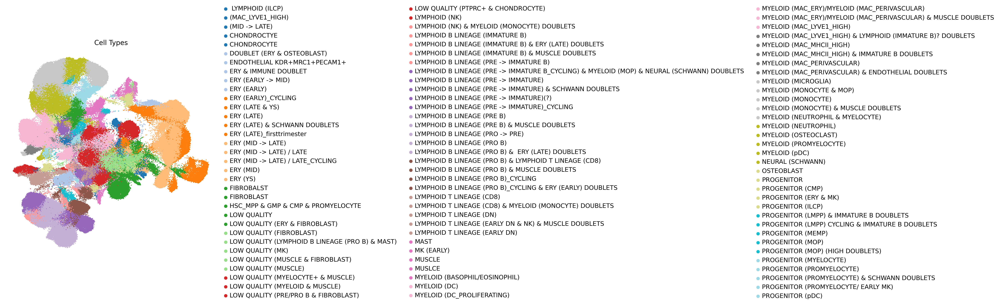

In [951]:
sc.settings.set_figure_params(figsize=(8, 8), dpi=100)  # adjust as needed

sc.pl.umap(
    adata_logged,
    color=['Haem_Manual_Annotation'],
    size=12,   
    groups=[],
    # Increase point size for better visibility
    legend_loc='right margin',  # Or 'right margin' if you want a separate legend
    frameon=False,
    title='Cell Types',
    palette= 'tab20'
              # High resolution
)


In [928]:
cX= adata_logged[adata_logged.obs['leiden_res_3']=='36,5'].copy()


In [929]:
cX.obs['fig_3_4'].value_counts()

fig_3_4
Lymphoid B lineage & Muscle (Doublets)      187
Lymphoid B lineage (pre_B)                    4
Muscle (Skeletal)                             2
Lymphoid B lineage (pro & pre_proB)           1
Myeloid (Neutrophil & Monocyte Doublets)      1
Name: count, dtype: int64

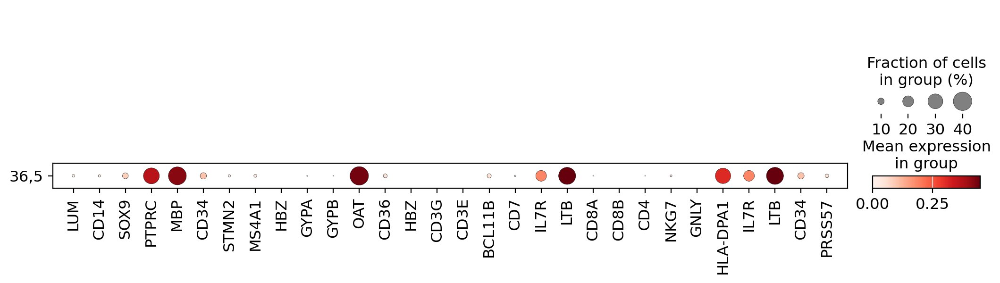

In [930]:
sc.pl.dotplot(cX, var_names=["LUM","CD14","SOX9","PTPRC","MBP","CD34","STMN2","MS4A1","HBZ","GYPA","GYPB","OAT","CD36","HBZ","CD3G","CD3E","BCL11B","CD7","IL7R","LTB","CD8A","CD8B","CD4","NKG7","GNLY","HLA-DPA1","IL7R","LTB","CD34","PRSS57"],
              groupby='leiden_res_3')

In [931]:
cX.obs['published_anno'].value_counts()

published_anno
pre pro B progenitor    1
Name: count, dtype: int64

In [932]:
cX.obs['propagated_anno_knn'].value_counts()

propagated_anno_knn
PAX7+ Myo                      93
PAX3+MyoProg                   45
pre B progenitor               37
low_confidence                  9
pre pro B progenitor            3
ELP                             2
MYH3+ Myo                       2
B_CELL                          1
DOUBLET_LYMPHOID_MACROPHAGE     1
Immune                          1
SMALL_PRE_B                     1
Name: count, dtype: int64

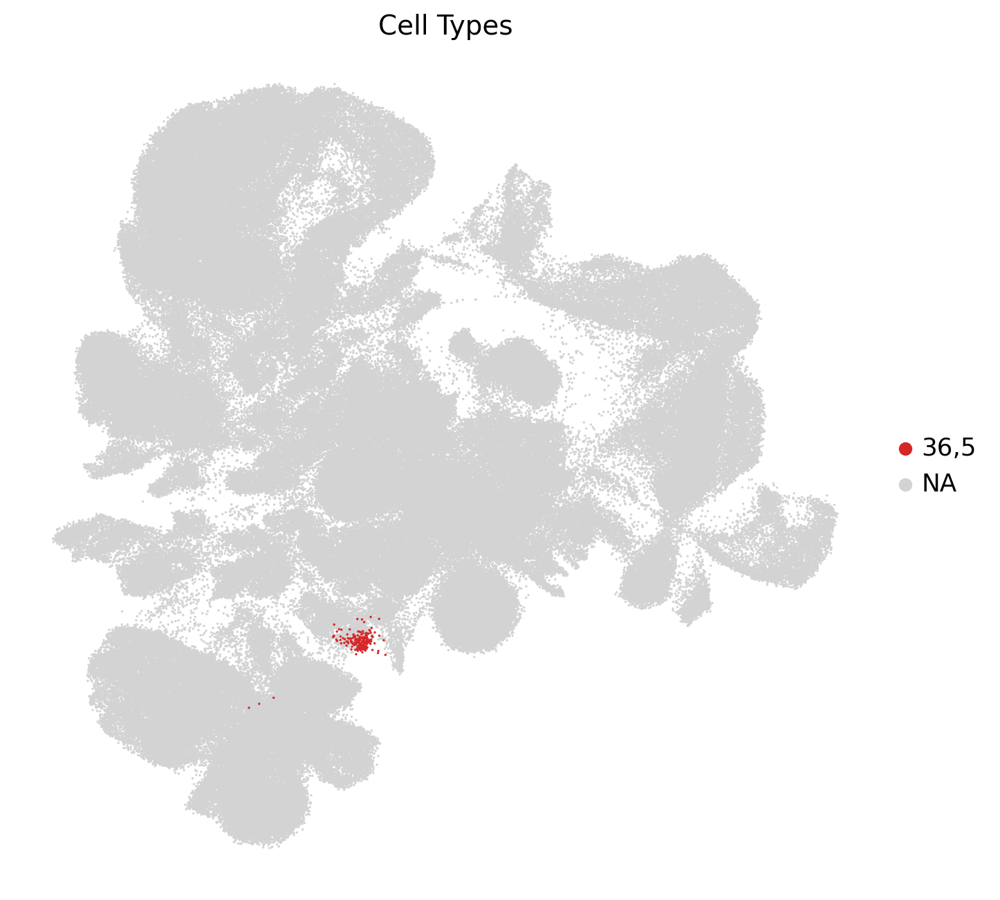

In [933]:
sc.settings.set_figure_params(figsize=(8, 8), dpi=100)  # adjust as needed

sc.pl.umap(
    adata_logged,
    color=['leiden_res_3'],
    size=6,   
    groups=['36,5'],
    # Increase point size for better visibility
    legend_loc='right margin',  # Or 'right margin' if you want a separate legend
    frameon=False,
    title='Cell Types',
    palette= 'tab10'
              # High resolution
)


# Subcluster

In [934]:
# # Re-cluster only cells currently labeled "83" in your existing Leiden
sc.tl.leiden(
    cX,
    resolution=0.5,                 # tweak as needed
    key_added="leiden_sub_36_5",      # new column for subclusters
    restrict_to=("leiden_res_3", ["36,5"]),neighbors_key='X_scVI'
    # neighbors_key="neighbors",    # <- set this ONLY if you used a custom key when calling sc.pp.neighbors
)

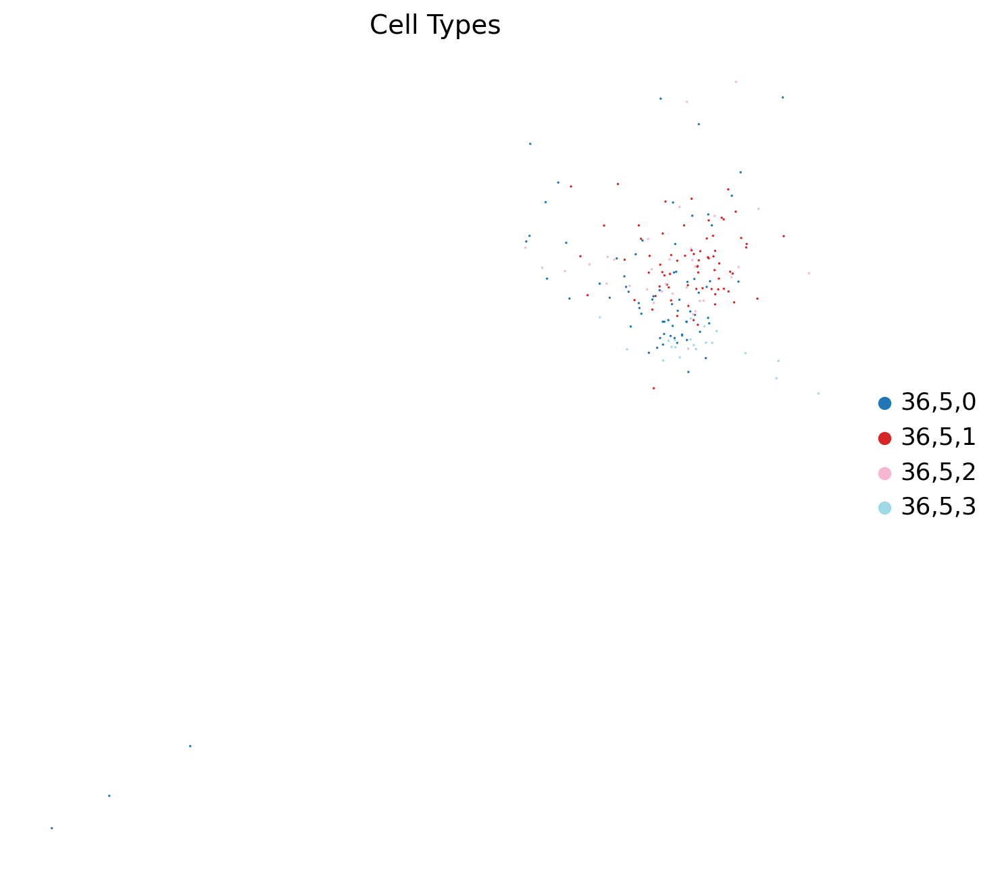

In [935]:
# sc.settings.set_figure_params(figsize=(8, 8), dpi=100)  # adjust as needed

sc.pl.umap(
    cX,
    color=['leiden_sub_36_5'],
    size=6,   
    groups=[],
    # Increase point size for better visibility
    legend_loc='right margin',  # Or 'right margin' if you want a separate legend
    frameon=False,
    title='Cell Types',
    palette= 'tab20'
              # High resolution
)


In [897]:
cX.obs['leiden_sub_44'].value_counts()

leiden_sub_44
44,0    767
44,1    634
44,2    458
44,3    370
44,4    312
44,5    284
44,6    143
Name: count, dtype: int64

#  Dotplots

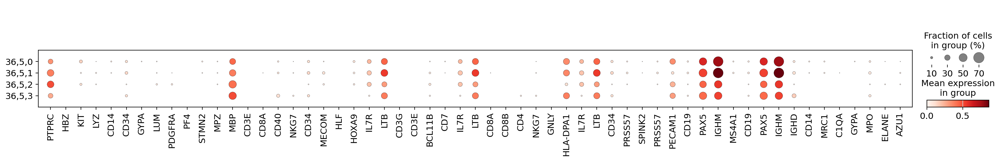

In [936]:
sc.pl.dotplot(cX, var_names=["PTPRC","HBZ","KIT","LYZ","CD14","CD34","GYPA","LUM","PDGFRA","PF4","STMN2","MPZ","MBP","CD3E","CD8A","CD40","NKG7","CD34","MECOM","HLF","HOXA9","IL7R","LTB","CD3G","CD3E","BCL11B","CD7","IL7R","LTB","CD8A","CD8B","CD4","NKG7","GNLY","HLA-DPA1","IL7R","LTB","CD34","PRSS57","SPINK2","PRSS57","PECAM1",'CD19', 'PAX5', 'IGHM', 'MS4A1','CD19', 'PAX5', 'IGHM', 'IGHD',"CD14","MRC1","C1QA","GYPA","MPO","ELANE","AZU1"]
              ,groupby="leiden_sub_36_5")

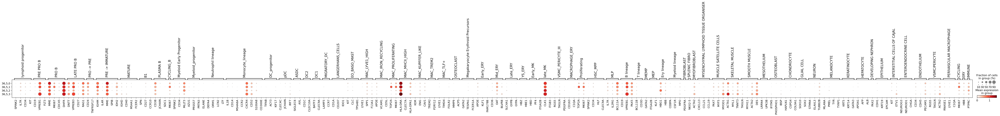

In [937]:
sc.pl.dotplot(cX, var_names= CATEGORY_MARKERS_pf,groupby="leiden_sub_36_5")

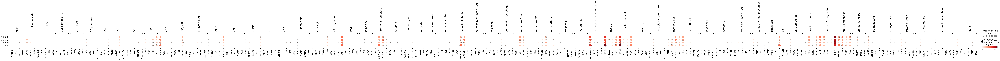

In [938]:
sc.pl.dotplot(cX, var_names= CATEGORY_MARKERS,groupby="leiden_sub_36_5")

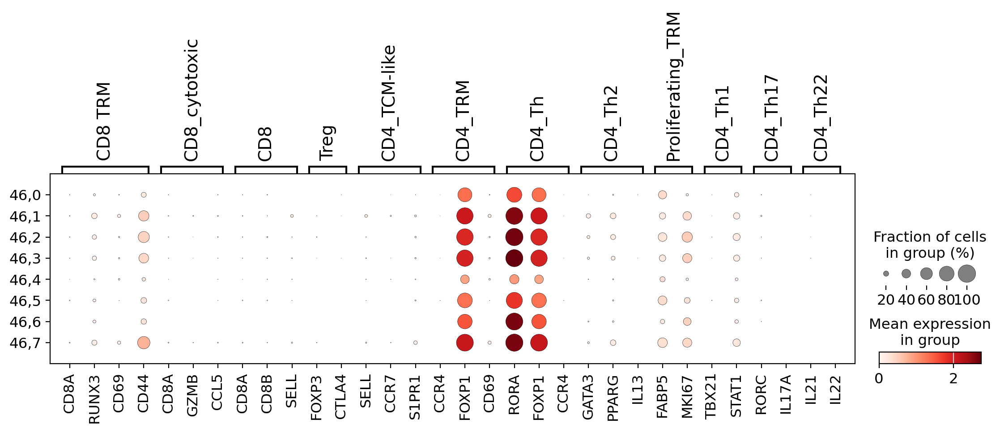

In [914]:
sc.pl.dotplot(cX, var_names=T_Cells,groupby="leiden_sub_46")

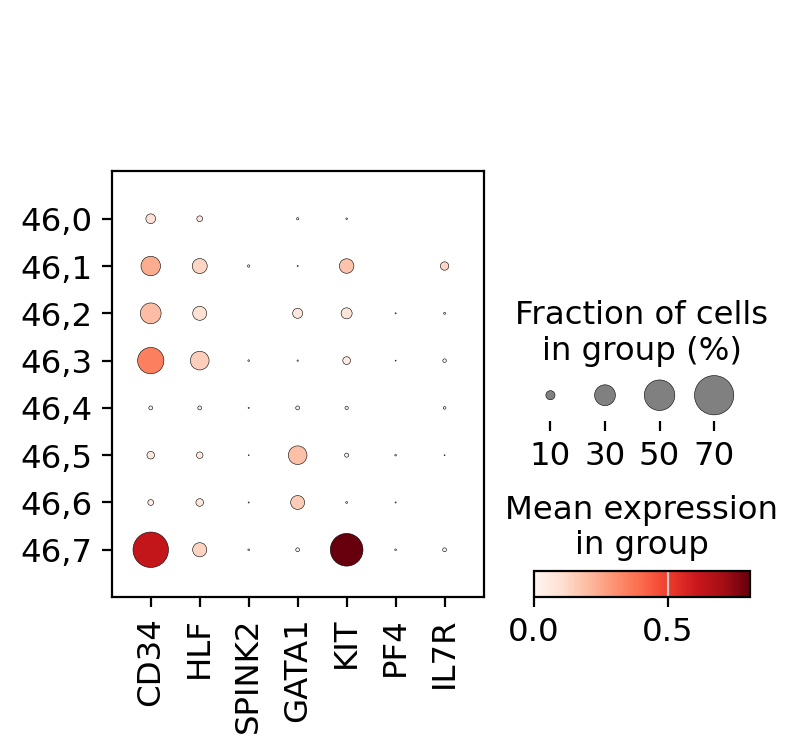

In [916]:
sc.pl.dotplot(cX, var_names=["CD34","HLF","SPINK2","GATA1","KIT","PF4","IL7R"],groupby="leiden_sub_46")

In [939]:
cX.obs['Manual_FBM_ChatGPT'].value_counts()

Manual_FBM_ChatGPT
muscle    195
Name: count, dtype: int64

In [941]:
pd.crosstab(cX.obs['predicted_doublets_unfiltered'],cX.obs['leiden_sub_36_5'])

leiden_sub_36_5,"36,5,0","36,5,1","36,5,2","36,5,3"
predicted_doublets_unfiltered,,,,
False,29,22,11,3
True,42,49,22,17


# Add subcluster to leiden_res_3

In [921]:
# # make sure indices align between cX and adata_logged
# assert all(cX.obs_names.isin(adata_logged.obs_names))

# # subset: cells in cX with leiden_sub_13 == "13,3"
# cells_to_update = cX.obs.index[cX.obs['leiden_sub_13'] == '13,3']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '13,3'

#####################################################################################
# # make sure indices align between cX and adata_logged
# assert all(cX.obs_names.isin(adata_logged.obs_names))

# # subset: cells in cX with leiden_sub_13 == "13,3"
# cells_to_update = cX.obs.index[cX.obs['leiden_sub_14'] == '14,2']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '14,2'



#####################################################################################


# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_16']


#####################################################################################
# make sure indices align between cX and adata_logged
# assert all(cX.obs_names.isin(adata_logged.obs_names))

# # subset: cells in cX with leiden_sub_13 == "13,3"
# cells_to_update = cX.obs.index[cX.obs['leiden_sub_21'] == '21,2']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '21,2'


# #####################################################################################
# #make sure indices align between cX and adata_logged
# assert all(cX.obs_names.isin(adata_logged.obs_names))

# # subset: cells in cX with leiden_sub_13 == "13,3"
# cells_to_update = cX.obs.index[cX.obs['leiden_sub_21'] == '21,6']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '21,6'

#####################################################################################

# #make sure indices align between cX and adata_logged
# assert all(cX.obs_names.isin(adata_logged.obs_names))

# # subset: cells in cX with leiden_sub_13 == "13,3"
# cells_to_update = cX.obs.index[cX.obs['leiden_sub_28'] == '28,6']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '28,6'

#####################################################################################

# assert all(cX.obs_names.isin(adata_logged.obs_names))

# # subset: cells in cX with leiden_sub_13 == "13,3"
# cells_to_update = cX.obs.index[cX.obs['leiden_sub_28'] == '28,0']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '28,0'

#####################################################################################

# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_33']


#####################################################################################

# assert all(cX.obs_names.isin(adata_logged.obs_names))


# cells_to_update = cX.obs.index[cX.obs['leiden_sub_35'] == '35,2']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '35,2'

#####################################################################################

# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_36']


#####################################################################################



# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_39']


#####################################################################################


# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_40']

#####################################################################################


# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_41']
# #####################################################################################



# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_42']
#####################################################################################

# make sure indices align between cX and adata_logged
# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index[cX.obs['leiden_sub_43'] == '43,3']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '43,3'



# #####################################################################################
# # make sure indices align between cX and adata_logged
# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index[cX.obs['leiden_sub_43'] == '43,7']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '43,7'

#####################################################################################


# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_44']


#####################################################################################


assert all(cX.obs_names.isin(adata_logged.obs_names))

cells_to_update = cX.obs.index.copy()
adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_46']


#####################################################################################

# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_48']

#####################################################################################
# #make sure indices align between cX and adata_logged
# # assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index[cX.obs['leiden_sub_49'] == '49,2']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '49,2'

# #####################################################################################

# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_50']

# #####################################################################################


# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_51']

#####################################################################################


# # make sure indices align between cX and adata_logged
# assert all(cX.obs_names.isin(adata_logged.obs_names))

# subset: cells in cX with leiden_sub_13 == "13,3"
# cells_to_update = cX.obs.index[cX.obs['leiden_sub_54'] == '54,4']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '54,4'
#####################################################################################

# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_55']

#####################################################################################
# cells_to_update = cX.obs.index[cX.obs['leiden_sub_56'] == '56,0']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '56,0'
#####################################################################################

# cells_to_update = cX.obs.index[cX.obs['leiden_sub_57'] == '57,0']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '57,0'
# #####################################################################################


# cells_to_update = cX.obs.index[cX.obs['leiden_sub_57'] == '57,4']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '57,4'
#####################################################################################


In [747]:
#####################################################################################

# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_58']

# #####################################################################################

# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_59']

# #####################################################################################


# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_60']

#####################################################################################

# cells_to_update = cX.obs.index[cX.obs['leiden_sub_63'] == '63,2']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '63,2'
# # #####################################################################################


# cells_to_update = cX.obs.index[cX.obs['leiden_sub_69'] == '69,3']
# adata_logged.obs['leiden_res_3']=adata_logged.obs['leiden_res_3'].astype(str)
# # update adata_logged.obs['leiden_res_3'] from "13" -> "13,3" only for those cells
# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = '69,3'
# # #####################################################################################



# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_70']

# # #####################################################################################


# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_72']

# # #####################################################################################



# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_73']

# # #####################################################################################



# assert all(cX.obs_names.isin(adata_logged.obs_names))

# cells_to_update = cX.obs.index.copy()
# adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

# adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_74']

# # #####################################################################################




assert all(cX.obs_names.isin(adata_logged.obs_names))

cells_to_update = cX.obs.index.copy()
adata_logged.obs['leiden_res_3'] = adata_logged.obs['leiden_res_3'].astype(str)

adata_logged.obs.loc[cells_to_update, 'leiden_res_3'] = cX.obs.loc[cells_to_update, 'leiden_sub_75']

# #####################################################################################



#  Doublet Scores 

In [948]:
#adata_logged_copy= adata_logged.copy()
cX.obs['predicted_doublets_unfiltered'].value_counts()

predicted_doublets_unfiltered
True     130
False     65
Name: count, dtype: int64

#  PF/FBM ANNOTATION OF CX

In [942]:
cX.obs['Manual_FBM_ChatGPT'].value_counts()

Manual_FBM_ChatGPT
muscle    195
Name: count, dtype: int64

In [943]:
cX.obs['Manual_PF_ChatGPT'].value_counts()

Manual_PF_ChatGPT
PRE -> IMMATURE    195
Name: count, dtype: int64

In [750]:
cX.obs['predicted_doublets_unfiltered'].value_counts()

predicted_doublets_unfiltered
False    193
True     113
Name: count, dtype: int64

In [415]:
cX.obs['predicted_doublets'].value_counts()

predicted_doublets
False    1384
True       35
None        1
Name: count, dtype: int64

In [211]:
MPC_Markers= {
    "myelopoiesis": ["KIT","LY6G6D",'LY6G6C',"CSF1R"], # CD117 is KIT; CD115 is CSF1R
    "B_lymphopoiesis.": ["IL7R","PTPRC","SPN","CD24"],
    "erythropoiesis": ["SLAMF1",'TFRC',"GYPA"], 
    "MPP2/MyE": ['SLAMF1',"CD48",],
    "MPP3/4/CMP": ["CD48",],
    "MkP": ['ITGA2B'],
    "HSC": ["SLAMF1","KIT","ESAM"]
}

In [212]:
cX.obs['Manual_FBM_ChatGPT'].value_counts()

Manual_FBM_ChatGPT
eosinophil    2149
Name: count, dtype: int64

#  CYCLING GENES 

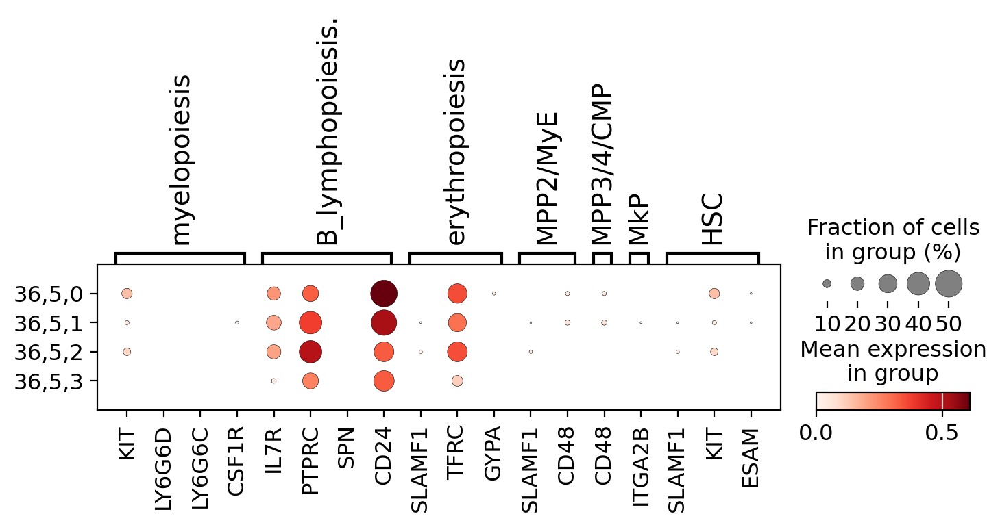

In [944]:
sc.pl.dotplot(cX, var_names= MPC_Markers,groupby="leiden_sub_36_5")

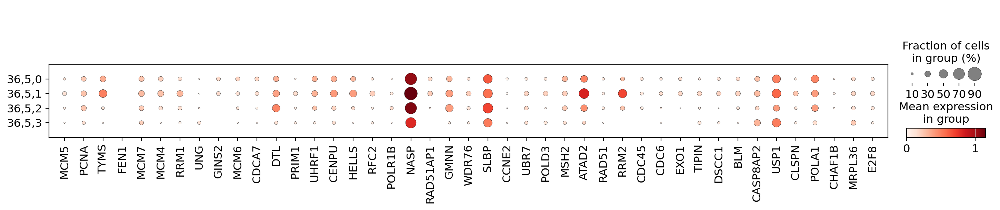

In [945]:
sc.pl.dotplot(cX, var_names= s_genes,groupby="leiden_sub_36_5")

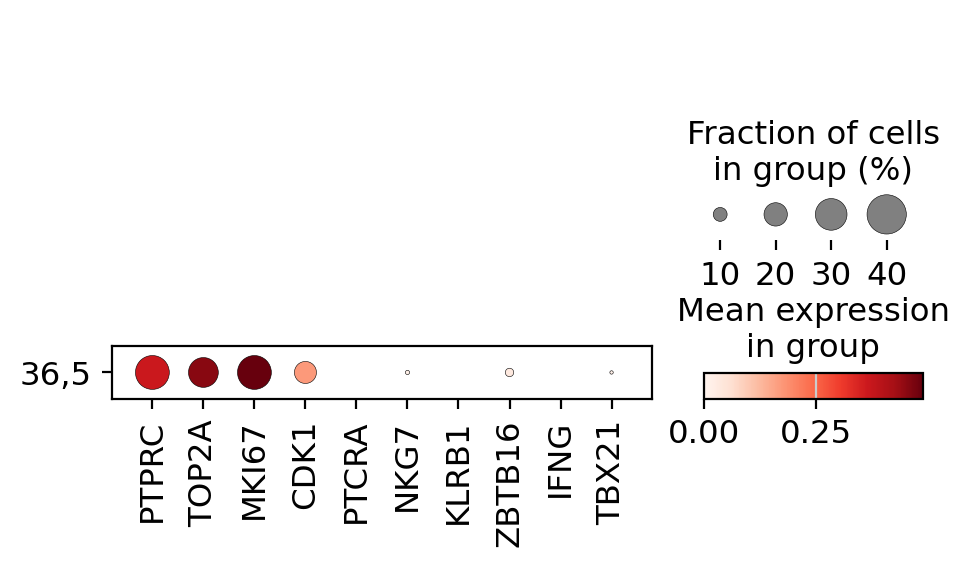

In [947]:
sc.pl.dotplot(cX, var_names= ["PTPRC","TOP2A","MKI67","CDK1",'PTCRA','NKG7',"KLRB1",'ZBTB16', 'IFNG', 'TBX21'],groupby="leiden_res_3")

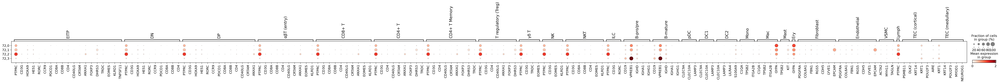

In [666]:
sc.pl.dotplot(cX, var_names= T_cell_type_genes,groupby="leiden_sub_72")

In [751]:
cX.obs['Organ'].value_counts()

Organ
Femur     168
Spine     138
Name: count, dtype: int64

In [752]:
cX.obs['Age_Final'].value_counts()

Age_Final
17    173
14     39
16     33
15     29
12     22
13     10
Name: count, dtype: int64

In [662]:
pd.crosstab(cX.obs['majority_voting'], cX.obs['leiden_sub_72'])

leiden_sub_72,"72,0","72,1","72,2","72,3"
majority_voting,,,,
Brain erythrocytes,0,0,1,0
CD5- mature B,0,1,3,0
CD8 T,0,0,1,0
CMP,1,0,0,0
DC2,0,0,3,0
DC2 precursor,0,0,1,0
Definitive erythrocytes,7,0,1,11
EPYC+ chondrocytes,0,1,0,0
Early erythroid,0,9,1,0


In [257]:
pd.crosstab(cX.obs['predicted_doublets_unfiltered'], cX.obs['Organ'])

Organ,Calvaria,Femur,Femur,Fibula,Hip,Hip/Knee,Hip/Shoulder,Knee,Long bone,Shoulder,Skull base,Skull base,Spine,Spine,Tibia
predicted_doublets_unfiltered,,,,,,,,,,,,,,,
False,26,37,15,2,22,1,2,57,5,35,68,9,0,833,1
True,12,6,0,0,1,0,1,91,0,19,2,1,0,453,0
nan,0,0,0,0,4,0,0,0,0,0,0,0,3,275,0


In [89]:
pd.crosstab(cX.obs['predicted_doublets'], cX.obs['Organ'])

Organ,Calvaria,Femur,Femur,Hip,Hip/Knee,Knee,Limb,Long bone,Shoulder,Skull base,Skull base,Skull base/Calvaria,Spine,Spine
predicted_doublets,,,,,,,,,,,,,,
False,74,64,8,7,0,34,1,3,7,6,7,1,1,1391
None,0,0,0,0,0,0,0,0,0,0,0,0,0,2
True,20,4,0,1,2,0,0,0,5,3,7,3,0,728


In [416]:
cX.obs['le'].value_counts()

leiden_sub_60
60,0    607
60,1    488
60,2    251
60,3     74
Name: count, dtype: int64

# SAVE ANNDATA AND ANNOTATIONS

In [954]:
adata_logged.write_h5ad('/nfs/team298/sm54/BoneAtlasProject/data/bone_haem_compartment/bone_haem_with_annotations.h5ad')
